<a href="https://colab.research.google.com/github/Karishma-2212/MIC_Hackathon_Team_Nanobots/blob/main/BN%20image%20for%20defects%20Untitled4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
### Load Necessary Libraries - Ensuring hyperspy is installed and imported
!pip install hyperspy
from skimage.feature import peak_local_max as MaxPeak
import numpy as np
import matplotlib.pyplot as plt
import hyperspy.api as hs
from scipy import ndimage
from matplotlib.legend_handler import HandlerPatch
import matplotlib.patches as mpatches
from matplotlib.patches import Circle
from matplotlib.patches import Rectangle
from scipy.optimize import curve_fit
from pylab import cm
import time
import copy
%matplotlib inline

In [ ]:
from matplotlib.legend_handler import HandlerPatch
import matplotlib.patches as mpatches

class HandlerEllipse(HandlerPatch):
    def create_artists(self, legend, orig_handle,
                       xdescent, ydescent, width, height, fontsize, trans):
        center = 0.5 * width - 0.5 * xdescent, 0.5 * height - 0.5 * ydescent
        p = mpatches.Ellipse(xy=center, width=width + xdescent,
                             height=height + ydescent)
        self.update_prop(p, orig_handle, legend)
        p.set_transform(trans)
        return [p]
def gauss(x,a,x0,sigma):
    return a*np.exp(-(x-x0)**2/sigma**2)
def bigauss(x,a1,a2,x01,x02,s1,s2):
    a=a1*np.exp(-(x-x01)**2/s1**2)
    b=a2*np.exp(-(x-x02)**2/s2**2)
    return a+b
def trigauss(x,a1,a2,a3,x01,x02,x03,s1,s2,s3):
    a=a1*np.exp(-(x-x01)**2/s1**2)
    b=a2*np.exp(-(x-x02)**2/s2**2)
    c=a3*np.exp(-(x-x03)**2/s3**2)
    return a+b+c
def tetragauss(x,a1,a2,a3,a4,x01,x02,x03,x04,s1,s2,s3,s4):
    a=a1*np.exp(-(x-x01)**2/s1**2)
    b=a2*np.exp(-(x-x02)**2/s2**2)
    c=a3*np.exp(-(x-x03)**2/s3**2)
    d=a4*np.exp(-(x-x04)**2/s4**2)
    return a+b+c+d
def pentagauss(x,a1,a2,a3,a4,a5,x01,x02,x03,x04,x05,s1,s2,s3,s4,s5):
    a=a1*np.exp(-(x-x01)**2/s1**2)
    b=a2*np.exp(-(x-x02)**2/s2**2)
    c=a3*np.exp(-(x-x03)**2/s3**2)
    d=a4*np.exp(-(x-x04)**2/s4**2)
    e=a5*np.exp(-(x-x05)**2/s5**2)
    return a+b+c+d+e

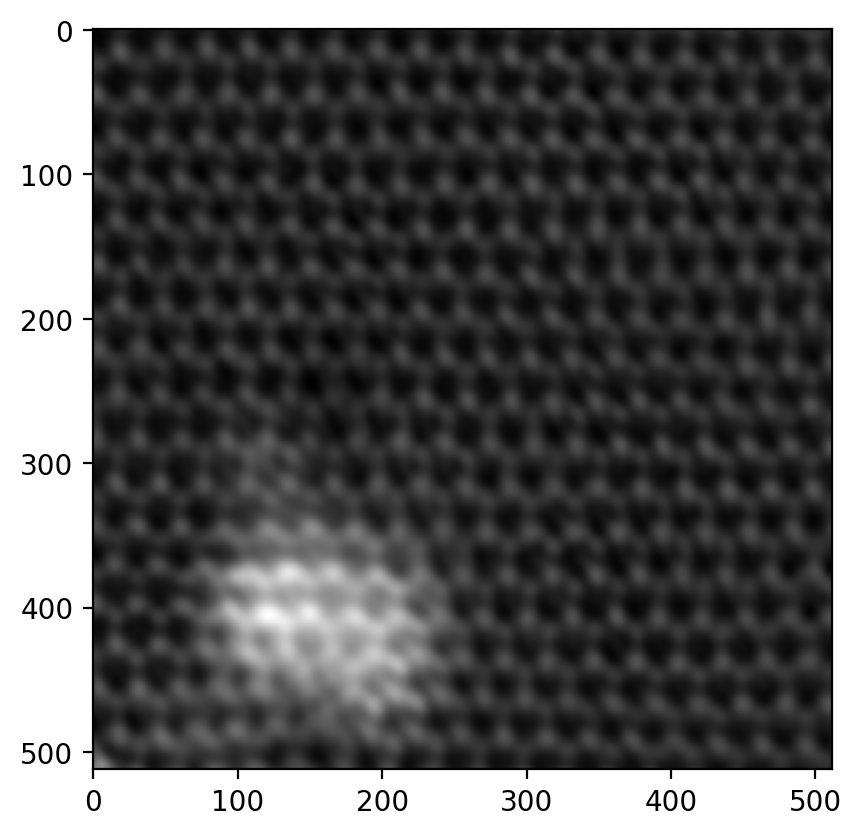

In [ ]:
import hyperspy.api as hs
StackIn = hs.load('/content/BN after FFT_Cut1_rotated1.dm3')
cal=StackIn.axes_manager[0].scale
Im=StackIn.data # Corrected: Removed np.sum to maintain 2D shape

### Optional Gaussian Bluring
Im = ndimage.gaussian_filter(Im, sigma=0.1)

### Normalize Image
nIm= (Im-np.amin(Im))/np.ptp(Im)

fig=plt.figure(dpi=200)
plt.imshow(nIm, cmap='gray')

Text(10, 500, '2 nm')

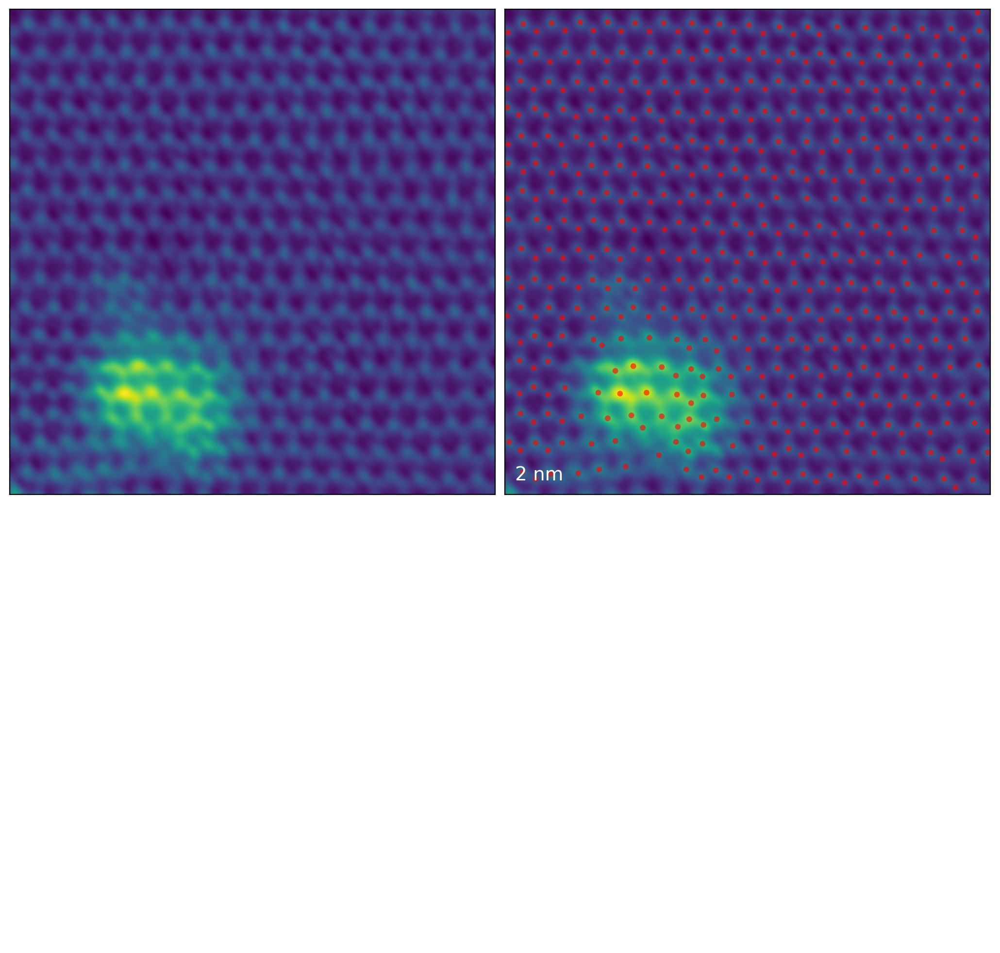

In [ ]:
### Find all atoms in image
r=2
allatoms=MaxPeak(nIm,r, threshold_rel=0.025,exclude_border=True)
fig=plt.figure(figsize=(10.2,5),dpi=200)
ax=fig.add_axes([0,0,0.5,1],xticks=[],yticks=[])
ax.imshow(nIm)
ax.add_patch(Rectangle((10,985),2/cal,0.2/cal,fc="white"))
ax.text(10,985,'2 nm',ha='left',va='bottom',fontsize=14,color='white')
ax=fig.add_axes([0.5,0,0.5,1],xticks=[],yticks=[])
ax.imshow(nIm)
for atom in allatoms: ax.add_patch(Circle(atom[::-1], radius=1.5*r, alpha =.6 ,fc='red',lw=0.25))
ax.add_patch(Rectangle((10,985),2/cal,0.2/cal,fc="white"))
ax.text(10,500,'2 nm',ha='left',va='bottom',fontsize=14,color='white')

(0.0, 1.0)

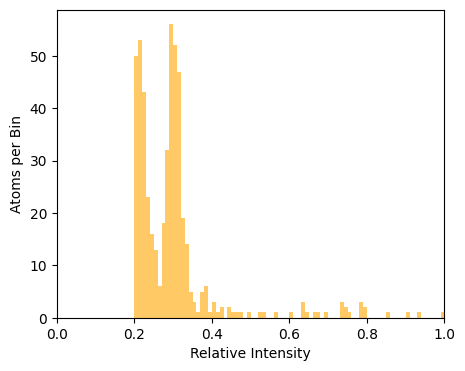

In [ ]:
allatoms = MaxPeak(nIm, min_distance=2, threshold_abs=0.2)
aint=[nIm[a[0]][a[1]] for a in allatoms]
fig=plt.figure(figsize=(5,4))
a=plt.hist(aint,100,range=(0,1),alpha=0.6,lw=0.5,color='Orange',histtype='stepfilled')
plt.xlabel('Relative Intensity')
plt.ylabel('Atoms per Bin')
plt.xlim(0,1)

In [ ]:
natoms=len(allatoms)
T=0.23 # Increased threshold for neighbor detection
def dist(a,b):
    return np.sqrt(np.sum((a[0]-b[0])**2+(a[1]-b[1])**2))
d=[];idx=[]
start=time.time()

### Step 1: Find Nearest Neighbors for all atoms
for i in range(natoms):
    if i==(natoms/100): print("1% in "+str(round(time.time()-start,2))+" seconds. Estimated Finish Time: "+str(round((time.time()-start)*100/60.,2))+" minutes")
    if i==(10*natoms/100):print("10% Finished")
    if i==(20*natoms/100):print("20% Finished")
    if i==(30*natoms/100):print("30% Finished")
    if i==(40*natoms/100):print("40% Finished")
    if i==(50*natoms/100):print("50% Finished")
    if i==(60*natoms/100):print("60% Finished")
    if i==(70*natoms/100):print("70% Finished")
    if i==(80*natoms/100):print("80% Finished")
    if i==(90*natoms/100):print("90% Finished")
    d.append([])
    idx.append([])
    for j in range(natoms):
        if i!=j and dist(allatoms[i],allatoms[j])*cal < T:
            d[i].append([(allatoms[i][1]-allatoms[j][1])*cal,(allatoms[i][0]-allatoms[j][0])*cal])
            idx[i].append(j)
ASite=[];BSite=[];BSitefromA=[];ASitefromB=[];Others=[]
step1=time.time()
print("Step 1 Time = " + str(step1-start) + " seconds")

### Step 2: Identify each atom as A-Site or B-Site depending on Coordination of Nearest Neighbors
###         (2 Above, 1 Below - A-Site, 2 Below, 1 Above - B-Site)
for i in range(natoms):
    if len(d[i])==3:
        pm=0
        for xyd in d[i]:
            if xyd[1]>0:pm+=1
            else: pm-=1
        if pm>0:
            ASite.append(i)
            BSitefromA.append(idx[i])
        else:
            BSite.append(i)
            ASitefromB.append(idx[i])
step2=time.time()
print("Step 2 Time = " + str(step2-step1) + " seconds")

### Step 3-7: If atom does not have 3 identified nearest neighbors, determine A/B identity by examinging labeled
###           nearest neighbors (if atom has all A-Site neighbors, identify as B-Site and vice versa). Loop
###           iteratively until all atoms identified. Throw away conflicts.
for a in ASite:
    if a in BSite:
        print("First Step")
        break
BfromA=[i for nn in BSitefromA for i in nn]
AfromB=[i for nn in ASitefromB for i in nn]
step3=time.time()
print("Step 3 Time = " + str(step3-step2) + " seconds")
for a in AfromB:
    if a not in ASite and a not in BSite: ASite.append(a)
for b in BfromA:
    if b not in BSite and b not in ASite: BSite.append(b)
Others=[]
for i in range(natoms):
    if i not in ASite and i not in BSite: Others.append(i)
for a in ASite:
    if a in BSite:
        print("Second Step")
        break
step4=time.time()
print("Step 4 Time = " + str(step4-step3) + " seconds")
print(natoms,len(ASite)+len(BSite)+len(Others),len(ASite),len(BSite),len(Others))
Changed=True
while Changed:
    print('Others Loop')
    NextO=[];Changed=False
    for o in Others:
        first=True;ProbA=False;ProbB=False
        for i in idx[o]:
            if first:
                first=False
                if i in ASite: ProbB=True
                if i in BSite: ProbA=True
            else:
                if i in ASite:
                    ProbB=True
                    if ProbA: ProbA=False;ProbB=False
                if i in BSite:
                    ProbA=True
                    if ProbB: ProbA=False;ProbB=False
        if ProbA and o not in ASite: ASite.append(o);Changed=True
        if ProbB and o not in BSite: BSite.append(o);Changed=True
        if not ProbA and not ProbB: NextO.append(o)
    Others=NextO
step5=time.time()
print("Step 5 Time = " + str(step5-step4) + " seconds")
print(len(allatoms),len(ASite)+len(BSite)+len(Others),len(ASite),len(BSite),len(Others))
oidx=[[] for i in range(natoms)]
for o in Others:
    for i in range(natoms):
        oidx[o].append((dist(allatoms[o],allatoms[i])*cal,i)) # Corrected oidx assignment
oidx=[sorted(o) for o in oidx]
step6=time.time()
print("Step 6 Time = " + str(step6-step5) + " seconds")
AfromO2=[];BfromO2=[]
for o_idx, o_neighbors in enumerate(oidx): # Iterating over enumerated oidx
    if o_idx not in Others: continue # Only process atoms still in Others list
    ino=0;ina=0;inb=0
    for oid_dist, oid_neighbor_idx in o_neighbors:
        if oid_neighbor_idx in Others: ino+=1
        elif oid_neighbor_idx in ASite: ina+=1 # Use elif for mutual exclusivity
        elif oid_neighbor_idx in BSite: inb+=1 # Use elif for mutual exclusivity
        if ina+inb-ino<-1: break
        if ina>1: AfromO2.append(o_idx); break
        if inb>1: BfromO2.append(o_idx); break

for a in AfromO2:
    if a not in ASite: ASite.append(a)
for b in BfromO2:
    if b not in BSite: BSite.append(b)

Others = [i for i in range(natoms) if (i not in ASite and i not in BSite)] # Recalculate Others
step7=time.time()
print("Step 7 Time = " + str(step7-step6) + " seconds")
print(len(allatoms),len(ASite)+len(BSite)+len(Others),len(ASite),len(BSite),len(Others))
Changed=True
while Changed:
    print('Others Loop')
    NextO=[];Changed=False
    for o in Others:
        if o in ASite: break
        if o in BSite: break
        first=True;ProbA=False;ProbB=False
        for i in idx[o]:
            if first:
                first=False
                if i in ASite: ProbB=True
                if i in BSite: ProbA=True
            else:
                if i in ASite:
                    ProbB=True
                    if ProbA: ProbA=False;ProbB=False
                if i in BSite:
                    ProbA=True
                    if ProbB: ProbA=False;ProbB=False
        if ProbA and o not in ASite: ASite.append(o);Changed=True
        if ProbB and o not in BSite: BSite.append(o);Changed=True
        if not ProbA and not ProbB: NextO.append(o)
    Others=NextO
step8=time.time()
print("Step 8 Time = " + str(step8-step7) + " seconds")
print(len(allatoms),len(ASite)+len(BSite)+len(Others),len(ASite),len(BSite),len(Others))

Step 1 Time = 4.655982971191406 seconds
Step 2 Time = 0.0008912086486816406 seconds
Step 3 Time = 0.0006053447723388672 seconds
Step 4 Time = 0.0035119056701660156 seconds
501 501 208 198 95
Others Loop
Others Loop
Others Loop
Step 5 Time = 0.0032279491424560547 seconds
501 501 237 249 15
Step 6 Time = 0.07311844825744629 seconds
Step 7 Time = 0.0024089813232421875 seconds
501 501 242 259 0
Others Loop
Step 8 Time = 0.00048422813415527344 seconds
501 501 242 259 0


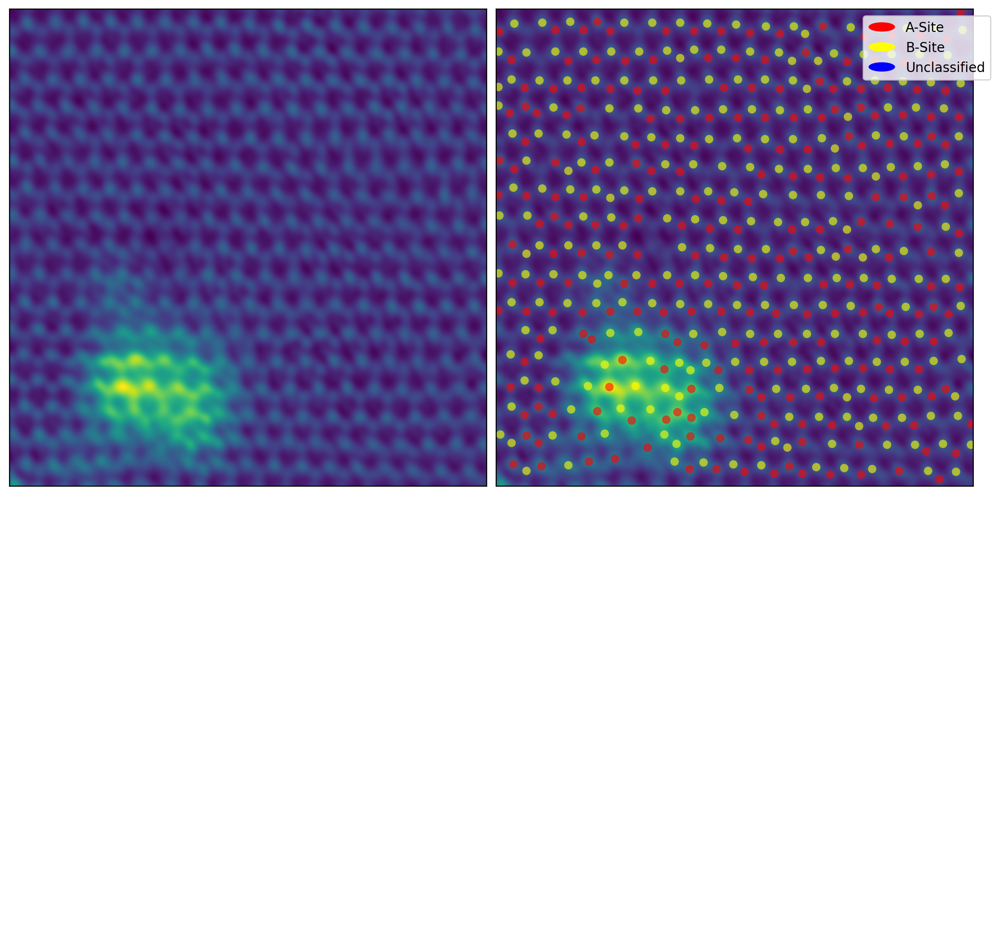

In [ ]:
### Show Result of AB Sorting
r = 3 # Defining r for the radius of the plotted circles
fig=plt.figure(figsize=(10.2,5),dpi=200)
ax=fig.add_axes([0,0,0.5,1],xticks=[],yticks=[])
ax.imshow(nIm)
ax.add_patch(Rectangle((10,985),2/cal,0.2/cal,fc="white"))
ax.text(10,985,'2 nm',ha='left',va='bottom',fontsize=14,color='white')
ax=fig.add_axes([0.5,0,0.5,1],xticks=[],yticks=[])
ax.imshow(nIm)

# Identify unclassified atoms
all_classified_indices = set(ASite + BSite)
UnclassifiedAtoms = []
for i in range(len(allatoms)):
    if i not in all_classified_indices:
        UnclassifiedAtoms.append(i)

for a_idx in ASite: ax.add_patch(Circle((allatoms[a_idx][1],allatoms[a_idx][0]),alpha=0.6, radius=1.5*r,fc='r',lw=0.25))
for b_idx in BSite: ax.add_patch(Circle((allatoms[b_idx][1],allatoms[b_idx][0]),alpha=0.6, radius=1.5*r,fc='Yellow',lw=0.25))
for u_idx in UnclassifiedAtoms: ax.add_patch(Circle((allatoms[u_idx][1],allatoms[u_idx][0]),alpha=0.6, radius=1.5*r,fc='blue',lw=0.25, label='Unclassified'))

ax.add_patch(Rectangle((10,985),2/cal,0.2/cal,fc="white"))
ax.text(10,985,'2 nm',ha='left',va='bottom',fontsize=14,color='white')

# Add a legend to indicate the unclassified atoms
# You might need to adjust legend position based on your plot
handles = [
    mpatches.Circle((0, 0), radius=2*r, fc='r', label='A-Site'),
    mpatches.Circle((0, 0), radius=2*r, fc='Yellow', label='B-Site'),
    mpatches.Circle((0, 0), radius=2*r, fc='BLUE', label='Unclassified')
]
ax.legend(handles=handles, loc='upper right', bbox_to_anchor=(1.05, 1), handler_map={mpatches.Circle: HandlerEllipse()})

A-sites: 225, B-sites: 271, Outliers: 5


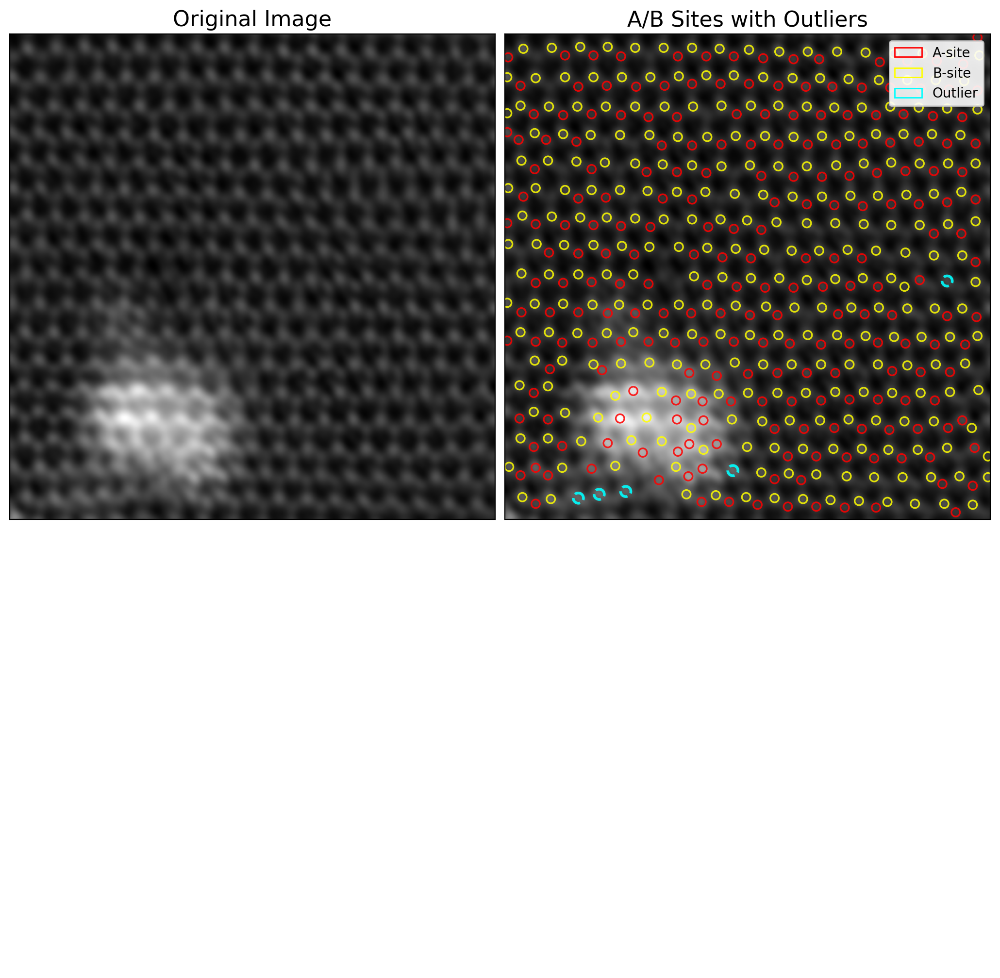

In [ ]:
# ============================================================
# VISUALIZE A/B SORTING + OUTLIERS
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Circle, Rectangle
import matplotlib.patches as mpatches

# --- Build coordinate lists
Aatoms = [allatoms[i] for i in ASite]
Batoms = [allatoms[i] for i in BSite]

# --- Define outliers safely
# Outliers = atoms not in ASite or BSite
all_idx = set(range(len(allatoms)))
outlier_idx = list(all_idx - set(ASite) - set(BSite))
Outliers = [allatoms[i] for i in outlier_idx]

print(f"A-sites: {len(Aatoms)}, B-sites: {len(Batoms)}, Outliers: {len(Outliers)}")

# --- Figure layout
fig = plt.figure(figsize=(10.2, 5), dpi=200)
ax1 = fig.add_axes([0, 0, 0.5, 1], xticks=[], yticks=[])
ax2 = fig.add_axes([0.5, 0, 0.5, 1], xticks=[], yticks=[])

# --- Left: original image
ax1.imshow(nIm, cmap='gray')
ax1.add_patch(Rectangle((10, 985), 2 / cal, 0.2 / cal, fc="white"))
ax1.text(10, 985, '2 nm', ha='left', va='bottom', fontsize=14, color='white')
ax1.set_title('Original Image', fontsize=16)

# --- Right: overlay
ax2.imshow(nIm, cmap='gray')

# A-sites (red)
for (row, col) in Aatoms:
    ax2.add_patch(
        Circle((col, row), radius=1.5*r,
               fill=False, ec='red', lw=1.2, alpha=0.85)
    )

# B-sites (yellow)
for (row, col) in Batoms:
    ax2.add_patch(
        Circle((col, row), radius=1.5*r,
               fill=False, ec='yellow', lw=1.2, alpha=0.85)
    )

# Outliers (cyan, dashed, thicker)
for (row, col) in Outliers:
    ax2.add_patch(
        Circle((col, row), radius=1.8*r,
               fill=False, ec='cyan', lw=2.0, ls='--', alpha=0.9)
    )

# Scale bar
ax2.add_patch(Rectangle((10, 985), 2 / cal, 0.2 / cal, fc="white"))
ax2.text(10, 985, '2 nm', ha='left', va='bottom', fontsize=14, color='white')
ax2.set_title('A/B Sites with Outliers', fontsize=16)

# --- Legend
legend_handles = [
    mpatches.Patch(facecolor='none', edgecolor='red', label='A-site'),
    mpatches.Patch(facecolor='none', edgecolor='yellow', label='B-site'),
    mpatches.Patch(facecolor='none', edgecolor='cyan', label='Outlier')
]
ax2.legend(handles=legend_handles, loc='upper right', framealpha=0.9)

plt.show()


In [ ]:
import numpy as np
import pandas as pd

# ---------------------------
# Helpers
# ---------------------------
img = np.asarray(nIm, dtype=float)
H, W = img.shape

coords = np.asarray(allatoms, dtype=float)  # [row,col]

def mean_intensity_circle(img2d, row, col, rad=2):
    rr = int(round(row)); cc = int(round(col))
    rmin, rmax = max(0, rr-rad), min(img2d.shape[0], rr+rad+1)
    cmin, cmax = max(0, cc-rad), min(img2d.shape[1], cc+rad+1)
    Rs = np.arange(rmin, rmax)
    Cs = np.arange(cmin, cmax)
    C, R = np.meshgrid(Cs, Rs)
    mask = (R-row)**2 + (C-col)**2 <= rad*rad
    vals = img2d[R[mask], C[mask]]
    return float(vals.mean()) if vals.size else np.nan

# ---------------------------
# 1) Intensities at detected atoms
# ---------------------------
atom_I = np.array([mean_intensity_circle(img, r0, c0, rad=max(1, int(1.5*r)))
                   for (r0, c0) in coords], dtype=float)

A_idx = np.asarray(ASite, dtype=int)
B_idx = np.asarray(BSite, dtype=int)

A_I = atom_I[A_idx]
B_I = atom_I[B_idx]

# ---------------------------
# 2) Intensity ranges for A and B (robust)
# ---------------------------
A_low, A_high = np.nanpercentile(A_I, [5, 95])
B_low, B_high = np.nanpercentile(B_I, [5, 95])

# vacancy threshold (very low intensity)
vacancy_thr = min(A_low, B_low)

print("=== INTENSITY RANGES USED ===")
print(f"A-site range (5–95%): {A_low:.4f} to {A_high:.4f}")
print(f"B-site range (5–95%): {B_low:.4f} to {B_high:.4f}")
print(f"Vacancy intensity threshold (min(A_low,B_low)): {vacancy_thr:.4f}")

# ---------------------------
# 3) Combine NN + intensity to assign status (keep A/B from geometry; add flags)
# ---------------------------
labels = []
for i, I in enumerate(atom_I):
    if i in set(A_idx):
        if I < vacancy_thr:
            labels.append("A (weak/vacancy-like)")
        elif (B_low <= I <= B_high):
            labels.append("A (antisite-candidate by intensity)")
        else:
            labels.append("A (ok)")
    elif i in set(B_idx):
        if I < vacancy_thr:
            labels.append("B (weak/vacancy-like)")
        elif (A_low <= I <= A_high):
            labels.append("B (antisite-candidate by intensity)")
        else:
            labels.append("B (ok)")
    else:
        # not labeled by NN (if you have any)
        labels.append("Unlabeled (NN outlier)")

df_atoms = pd.DataFrame({
    "row": coords[:,0],
    "col": coords[:,1],
    "intensity": atom_I,
    "NN_label": ["A" if i in set(A_idx) else ("B" if i in set(B_idx) else "None") for i in range(len(coords))],
    "status": labels
})

print("\n=== ATOM STATUS COUNTS ===")
print(df_atoms["status"].value_counts())

# ---------------------------
# 4) Intensity at missing-atom (vacancy) locations
# ---------------------------
vac_list = np.asarray(vacancies_rc, dtype=float) if "vacancies_rc" in globals() else np.empty((0,2), dtype=float)

vac_I = []
for (r0, c0) in vac_list:
    vac_I.append(mean_intensity_circle(img, r0, c0, rad=max(1, int(1.5*r))))
vac_I = np.asarray(vac_I, dtype=float)

df_vac = pd.DataFrame({
    "row": vac_list[:,0] if len(vac_list) else [],
    "col": vac_list[:,1] if len(vac_list) else [],
    "intensity": vac_I,
    "is_low_intensity": (vac_I < vacancy_thr) if len(vac_I) else []
})

print("\n=== VACANCY CHECK ===")
print("Vacancy candidates:", len(df_vac))
if len(df_vac):
    print("Low-intensity confirmed vacancies:", int(df_vac["is_low_intensity"].sum()))

# df_atoms and df_vac are your outputs for analysis/plots


=== INTENSITY RANGES USED ===
A-site range (5–95%): 0.1913 to 0.4067
B-site range (5–95%): 0.2162 to 0.5453
Vacancy intensity threshold (min(A_low,B_low)): 0.1913

=== ATOM STATUS COUNTS ===
status
B (antisite-candidate by intensity)    237
A (ok)                                 137
A (antisite-candidate by intensity)     92
B (ok)                                  20
A (weak/vacancy-like)                   13
B (weak/vacancy-like)                    2
Name: count, dtype: int64

=== VACANCY CHECK ===
Vacancy candidates: 0


# New Section

Ref atoms: 74  Defect atoms: 73
Estimated NN spacing (px) in ref ROI: 17.0
Ref lattice direction u1: [0.47715876 0.87881711]  u2: [0.99965732 0.02617695]
Defect ROI displacement magnitude: median(px)= 4.019447658830434  max(px)= 10.429517847845746


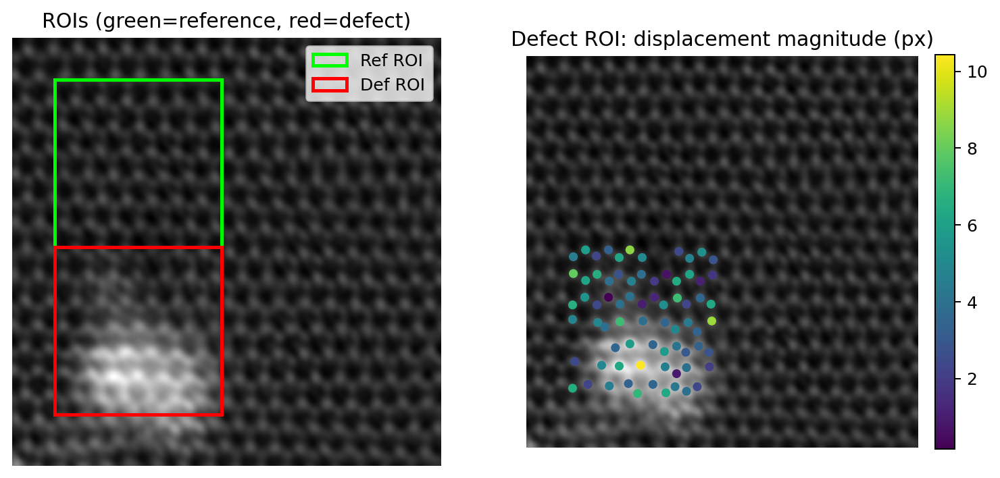

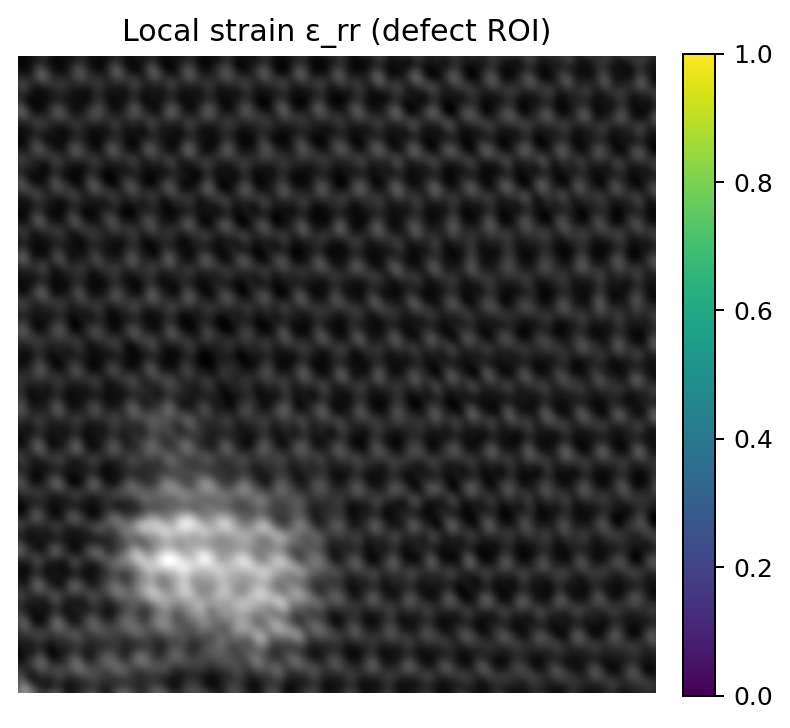

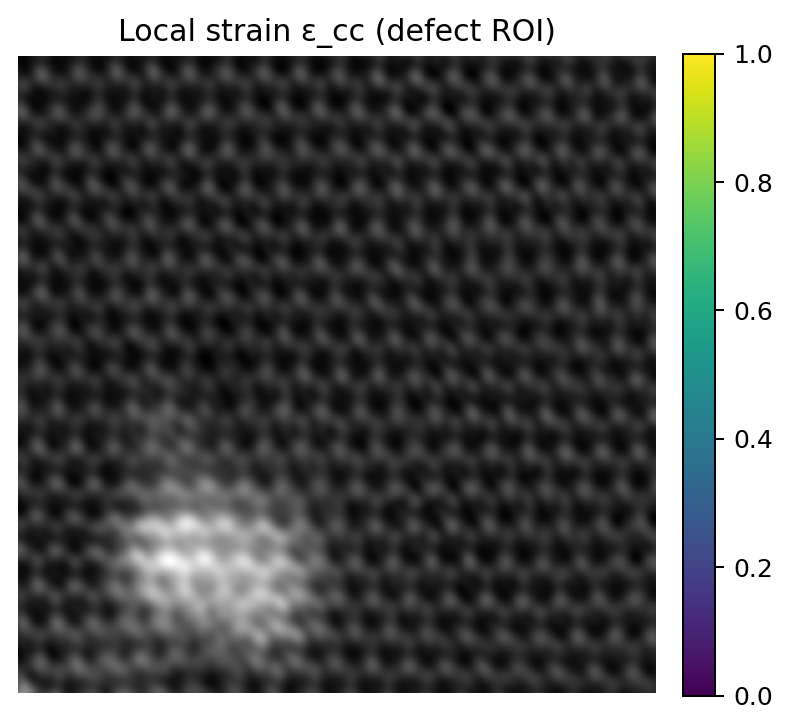

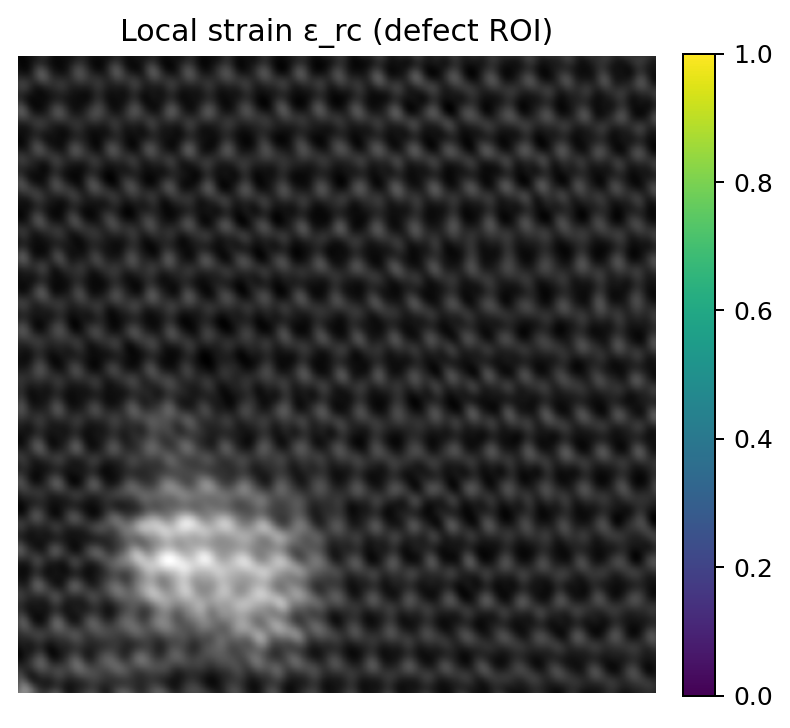

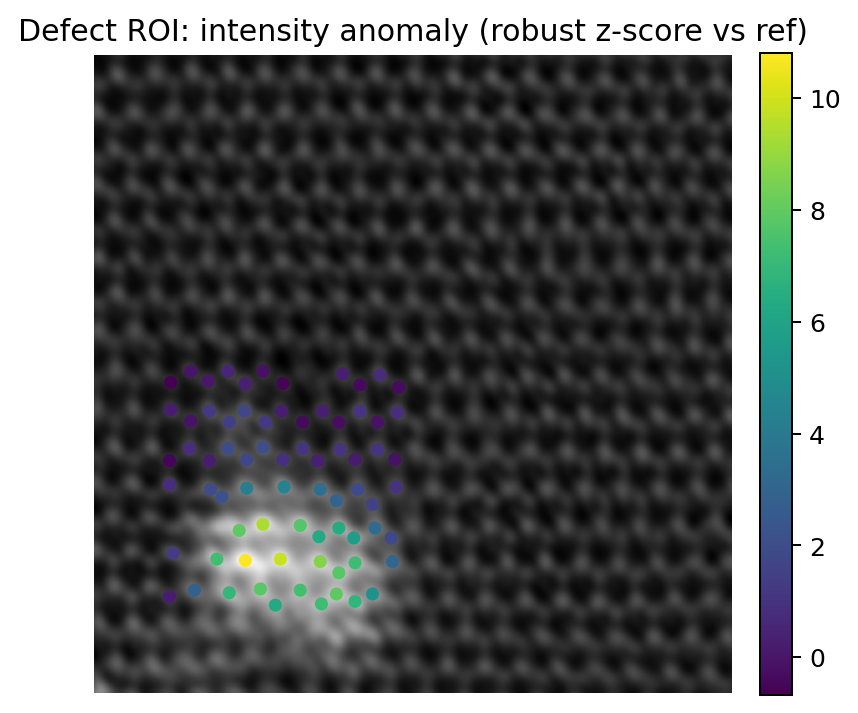


Reference intensity summary:
median = 0.22813236235100545  IQR = 0.06777828103966185
Defect intensity summary:
median = 0.3255558768172323  IQR = 0.3657726341927493


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial import cKDTree
from matplotlib.patches import Rectangle

# ============================================================
# Reference vs Defect Region Analyzer (strain + intensity)
#
# Inputs you already have:
#   nIm      : 2D image
#   allatoms : list/array of [row, col] (detected peaks)
#   r        : peak radius (pixels)
#
# You set these two rectangles (in PIXELS):
#   ref_box = (r0, r1, c0, c1)   # perfect region
#   def_box = (r0, r1, c0, c1)   # defect region
# ============================================================

img = np.asarray(nIm, dtype=float)
H, W = img.shape
atoms = np.asarray(allatoms, dtype=float)  # [row,col]
tree = cKDTree(atoms)

# -----------------------
# USER: set ROIs here
# -----------------------
ref_box = (50, 250, 50, 250)     # (row_min,row_max,col_min,col_max) perfect region
def_box = (250, 450, 50, 250)   # defect region example - Corrected to be within image bounds
# -----------------------

def in_box(rc, box):
    r0, r1, c0, c1 = box
    return (r0 <= rc[0] <= r1) and (c0 <= rc[1] <= c1)

ref_atoms = np.array([a for a in atoms if in_box(a, ref_box)], dtype=float)
def_atoms = np.array([a for a in atoms if in_box(a, def_box)], dtype=float)

print("Ref atoms:", len(ref_atoms), " Defect atoms:", len(def_atoms))
if len(ref_atoms) < 20 or len(def_atoms) < 20:
    print("WARNING: one ROI has too few atoms. Increase ROI size.")

# ------------------------------------------------------------
# 1) Estimate reference lattice spacing + directions from ref ROI
#    Use nearest-neighbor vectors and take the two dominant directions.
# ------------------------------------------------------------
ref_tree = cKDTree(ref_atoms)
d2, nn2 = ref_tree.query(ref_atoms, k=2)  # self + nearest
nn_spacing = float(np.median(d2[:,1]))
print("Estimated NN spacing (px) in ref ROI:", nn_spacing)

# Collect many NN vectors (ref atoms -> their 6 nearest)
k = 7
dK, nnK = ref_tree.query(ref_atoms, k=k)
vecs = []
for i in range(len(ref_atoms)):
    center = ref_atoms[i]
    nbrs = ref_atoms[nnK[i][1:]]   # skip self
    for nb in nbrs:
        v = nb - center  # [drow, dcol]
        # keep only near first shell
        if np.linalg.norm(v) < 1.4*nn_spacing:
            vecs.append(v)
vecs = np.array(vecs, dtype=float)

# Normalize vectors and fold sign (v and -v same direction)
vn = vecs / (np.linalg.norm(vecs, axis=1, keepdims=True) + 1e-12)
vn = np.where(vn[:,[0]] < 0, -vn, vn)  # flip so drow >=0 (arbitrary fold)

# Cluster directions into 2 dominant axes using kmeans on angle
angles = np.arctan2(vn[:,0], vn[:,1])  # angle in (row,col) space
# simple: take histogram peaks
hist, bins = np.histogram(angles, bins=60, range=(-np.pi/2, np.pi/2))
peak_ids = np.argsort(hist)[-2:]
ang1 = float((bins[peak_ids[0]] + bins[peak_ids[0]+1]) / 2)
ang2 = float((bins[peak_ids[1]] + bins[peak_ids[1]+1]) / 2)

def ang_to_unit(a):
    # unit vector in [drow,dcol]
    return np.array([np.sin(a), np.cos(a)], dtype=float)

u1 = ang_to_unit(ang1)
u2 = ang_to_unit(ang2)

# Make sure they aren't nearly parallel; if they are, pick farthest peak
if abs(np.dot(u1,u2)) > 0.9:
    peak_ids = np.argsort(hist)[-3:]
    ang2 = float((bins[peak_ids[0]] + bins[peak_ids[0]+1]) / 2)
    u2 = ang_to_unit(ang2)

print("Ref lattice direction u1:", u1, " u2:", u2)

# ------------------------------------------------------------
# 2) Fit an affine map from "ideal reference grid" -> measured ref atoms
#    We build ideal coordinates by projecting ref atoms onto (u1,u2),
#    rounding to nearest integer grid.
# ------------------------------------------------------------
# Project ref atoms onto basis
origin = ref_atoms.mean(axis=0)
proj1 = (ref_atoms - origin) @ u1
proj2 = (ref_atoms - origin) @ u2

# Convert to grid indices (integer lattice coords)
s1 = np.median(np.abs(vecs @ u1))  # approximate spacing along u1
s2 = np.median(np.abs(vecs @ u2))  # approximate spacing along u2
s1 = s1 if np.isfinite(s1) and s1 > 1e-6 else nn_spacing
s2 = s2 if np.isfinite(s2) and s2 > 1e-6 else nn_spacing

g1 = np.round(proj1 / s1)
g2 = np.round(proj2 / s2)

# Build design matrix for affine fit: [g1 g2 1] -> [row col]
G = np.vstack([g1, g2, np.ones_like(g1)]).T  # (N,3)
Y = ref_atoms  # (N,2)

# Least squares affine
A_aff, *_ = np.linalg.lstsq(G, Y, rcond=None)  # (3,2)
# Prediction function: given (g1,g2) -> [row,col]
def predict_from_grid(g1v, g2v):
    Gv = np.vstack([g1v, g2v, np.ones_like(g1v)]).T
    return Gv @ A_aff  # (N,2)

# ------------------------------------------------------------
# 3) For DEFECT ROI: assign each atom a grid coordinate and compute displacement
# ------------------------------------------------------------

# Only proceed if def_atoms is not empty
if len(def_atoms) > 0:
    def_origin = def_atoms.mean(axis=0)
    proj1_d = (def_atoms - origin) @ u1
    proj2_d = (def_atoms - origin) @ u2
    g1_d = np.round(proj1_d / s1)
    g2_d = np.round(proj2_d / s2)

    ideal_def = predict_from_grid(g1_d, g2_d)  # expected positions if perfect
    disp = def_atoms - ideal_def               # displacement vectors [drow,dcol]
    disp_mag = np.linalg.norm(disp, axis=1)

    print("Defect ROI displacement magnitude: median(px)=", float(np.median(disp_mag)),
          " max(px)=", float(np.max(disp_mag)))

    # ------------------------------------------------------------
    # 4) Strain estimate: local affine fits around each atom (small neighborhood)
    #    Gives ε_xx, ε_yy, ε_xy in image coords (row/col space).
    # ------------------------------------------------------------
    def_tree = cKDTree(def_atoms)
    R_loc = 1.6 * nn_spacing  # neighborhood radius
    exx = np.full(len(def_atoms), np.nan)
    eyy = np.full(len(def_atoms), np.nan)
    exy = np.full(len(def_atoms), np.nan)

    for i, p in enumerate(def_atoms):
        nbr = def_tree.query_ball_point(p, r=R_loc)
        if len(nbr) < 6:
            continue
        P = def_atoms[nbr] - p
        Q = ideal_def[nbr] - ideal_def[i]  # ideal neighbor vectors

        # Fit linear map F: Q -> P (P ≈ F Q)
        # Solve Q * F^T = P  => F^T = (Q^+ P)
        # Q: (m,2), P:(m,2)
        F_T, *_ = np.linalg.lstsq(Q, P, rcond=None)  # (2,2)
        F = F_T.T

        # Small strain tensor: eps = 0.5*(F + F^T) - I
        eps = 0.5*(F + F.T) - np.eye(2)
        # eps in [row,col] coordinates:
        exx[i] = eps[0,0]
        eyy[i] = eps[1,1]
        exy[i] = eps[0,1]

    # ------------------------------------------------------------
    # 5) Intensity anomaly in defect ROI: compare to reference distribution
    # ------------------------------------------------------------
    def get_I(points, rad=max(1, int(1.5*r))):
        return np.array([np.mean(img[
            max(0,int(round(rr-rad))):min(H,int(round(rr+rad+1))),
            max(0,int(round(cc-rad))):min(W,int(round(cc+rad+1)))
        ]) for rr,cc in points], dtype=float)

    I_ref = get_I(ref_atoms)
    I_def = get_I(def_atoms)

    I_ref_med = float(np.median(I_ref))
    I_ref_iqr = float(np.percentile(I_ref, 75) - np.percentile(I_ref, 25) + 1e-12) # Added 1e-12 to prevent division by zero for very uniform images
    z_def = (I_def - I_ref_med) / I_ref_iqr  # robust z-score (not Gaussian)

    # ------------------------------------------------------------
    # 6) Plot: ROIs + displacement + strain + intensity anomaly
    # ------------------------------------------------------------
    fig, ax = plt.subplots(1, 2, figsize=(10,5), dpi=180)
    ax[0].imshow(img, cmap="gray")
    ax[0].add_patch(Rectangle((ref_box[2], ref_box[0]), ref_box[3]-ref_box[2], ref_box[1]-ref_box[0],
                              fill=False, ec="lime", lw=2, label="Ref ROI"))
    ax[0].add_patch(Rectangle((def_box[2], def_box[0]), def_box[3]-def_box[2], def_box[1]-def_box[0],
                              fill=False, ec="red", lw=2, label="Def ROI"))
    ax[0].set_title("ROIs (green=reference, red=defect)")
    ax[0].axis("off")
    ax[0].legend(loc="upper right")

    ax[1].imshow(img, cmap="gray")
    # overlay displacement magnitude as colored dots
    sc = ax[1].scatter(def_atoms[:,1], def_atoms[:,0], c=disp_mag, s=18)
    ax[1].set_title("Defect ROI: displacement magnitude (px)")
    ax[1].axis("off")
    plt.colorbar(sc, ax=ax[1], fraction=0.046, pad=0.04)
    plt.show()

    # Strain plots (scatter)
    for name, vals in [("ε_rr", exx), ("ε_cc", eyy), ("ε_rc", exy)]:
        plt.figure(figsize=(5,5), dpi=180)
        plt.imshow(img, cmap="gray")
        m = np.isfinite(vals)
        sc = plt.scatter(def_atoms[m,1], def_atoms[m,0], c=vals[m], s=18)
        plt.title(f"Local strain {name} (defect ROI)")
        plt.axis("off")
        plt.colorbar(sc, fraction=0.046, pad=0.04)
        plt.show()

    # Intensity anomaly plot
    plt.figure(figsize=(5,5), dpi=180)
    plt.imshow(img, cmap="gray")
    sc = plt.scatter(def_atoms[:,1], def_atoms[:,0], c=z_def, s=18)
    plt.title("Defect ROI: intensity anomaly (robust z-score vs ref)")
    plt.axis("off")
    plt.colorbar(sc, fraction=0.046, pad=0.04)
    plt.show()

    print("\nReference intensity summary:")
    print("median =", np.median(I_ref), " IQR =", np.percentile(I_ref,75)-np.percentile(I_ref,25))
    print("Defect intensity summary:")
    print("median =", np.median(I_def), " IQR =", np.percentile(I_def,75)-np.percentile(I_def,25))
else:
    print("Cannot perform defect analysis: Defect ROI is empty.")


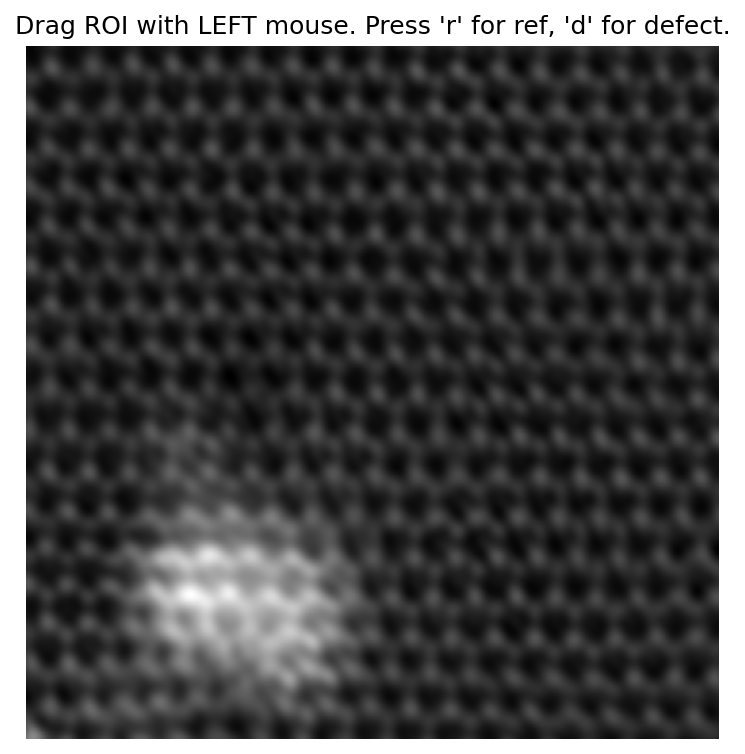

Instructions: press 'r' or 'd', then LEFT-click + drag a rectangle on the image.


In [ ]:
%matplotlib inline

import matplotlib.pyplot as plt
from matplotlib.widgets import RectangleSelector
import numpy as np

img = np.asarray(nIm)

boxes = {"ref": None, "def": None}
mode = {"current": "ref"}  # press 'r' or 'd' to switch

fig, ax = plt.subplots(1, 1, figsize=(6, 6), dpi=150)
ax.imshow(img, cmap="gray")
ax.set_title("Drag ROI with LEFT mouse. Press 'r' for ref, 'd' for defect.")
ax.axis("off")

def onselect(eclick, erelease):
    # eclick/erelease store mouse-down and mouse-up
    x1, y1 = eclick.xdata, eclick.ydata
    x2, y2 = erelease.xdata, erelease.ydata
    if x1 is None or x2 is None or y1 is None or y2 is None:
        return
    c0, c1 = sorted([x1, x2])
    r0, r1 = sorted([y1, y2])
    box = (int(r0), int(r1), int(c0), int(c1))
    boxes[mode["current"]] = box
    print(f"{mode['current'].upper()} box = {box}   # (r0,r1,c0,c1)")

def onkeypress(event):
    if event.key == "r":
        mode["current"] = "ref"
        print("Mode: REF ROI (press and drag)")
    elif event.key == "d":
        mode["current"] = "def"
        print("Mode: DEF ROI (press and drag)")

rs = RectangleSelector(
    ax, onselect,
    useblit=True,
    button=[1],          # left mouse only
    interactive=True,
    drag_from_anywhere=True
)

fig.canvas.mpl_connect("key_press_event", onkeypress)
plt.show()

print("Instructions: press 'r' or 'd', then LEFT-click + drag a rectangle on the image.")

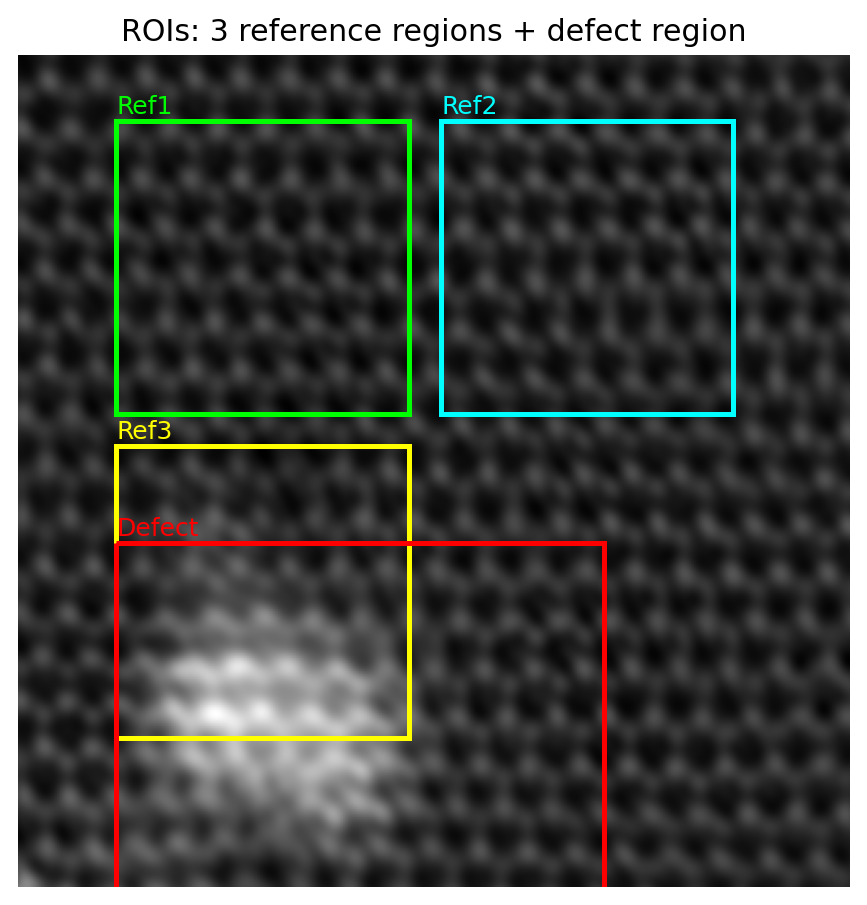


=== SUMMARY TABLE (lower displacement/strain in refs = better 'perfect') ===


/tmp/ipython-input-3708320617.py:200: RuntimeWarning: All-NaN slice encountered
  strain_rr_median=float(np.nanmedian(exx)),
/tmp/ipython-input-3708320617.py:201: RuntimeWarning: All-NaN slice encountered
  strain_cc_median=float(np.nanmedian(eyy)),
/tmp/ipython-input-3708320617.py:202: RuntimeWarning: All-NaN slice encountered
  strain_rc_median=float(np.nanmedian(exy)),


,roi,model,n,disp_median,disp_95,strain_rr_median,strain_cc_median,strain_rc_median,I_median,zI_median,I_ref_median,I_ref_iqr
0,Defect,Ref1,112,9.476140,19.186578,-0.102110,0.020780,-0.035546,0.306023,0.519105,0.265365,0.078322
1,Defect,Ref2,112,5.392091,10.709136,NaN,NaN,NaN,0.306023,0.569905,0.260083,0.080609
2,Defect,Ref3,112,4.982193,7.929090,-0.127561,-0.252418,0.015974,0.306023,-0.094550,0.325733,0.208467
3,Ref1,Ref1,64,4.261724,7.990152,NaN,NaN,NaN,0.265365,0.000000,0.265365,0.078322
4,Ref1,Ref1,64,4.261724,7.990152,NaN,NaN,NaN,0.265365,0.000000,0.265365,0.078322
5,Ref1,Ref2,64,9.573051,16.498917,NaN,NaN,NaN,0.265365,0.065529,0.260083,0.080609
6,Ref1,Ref3,64,4.866474,7.835151,NaN,NaN,NaN,0.265365,-0.289580,0.325733,0.208467
7,Ref2,Ref1,67,11.953596,18.804668,NaN,NaN,NaN,0.260083,-0.067443,0.265365,0.078322
8,Ref2,Ref2,67,3.839021,7.293254,NaN,NaN,NaN,0.260083,0.000000,0.260083,0.080609
9,Ref2,Ref2,67,3.839021,7.293254,NaN,NaN,NaN,0.260083,0.000000,0.260083,0.080609



=== QUICK CHECK: Reference uniformity (cross-ref) ===


model,Ref1,Ref2,Ref3
roi,,,
Ref1,4.261724,9.573051,4.866474
Ref2,11.953596,3.839021,6.823048
Ref3,7.076966,5.571207,4.701075



Best reference model (most self-consistent): Ref2


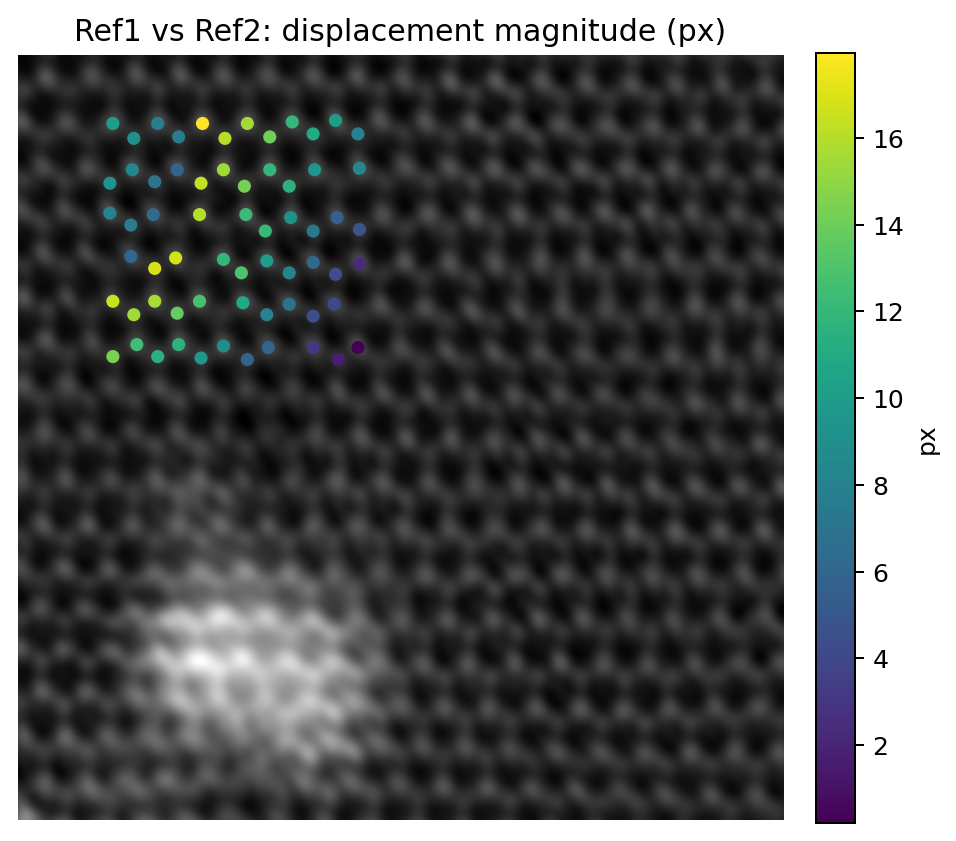

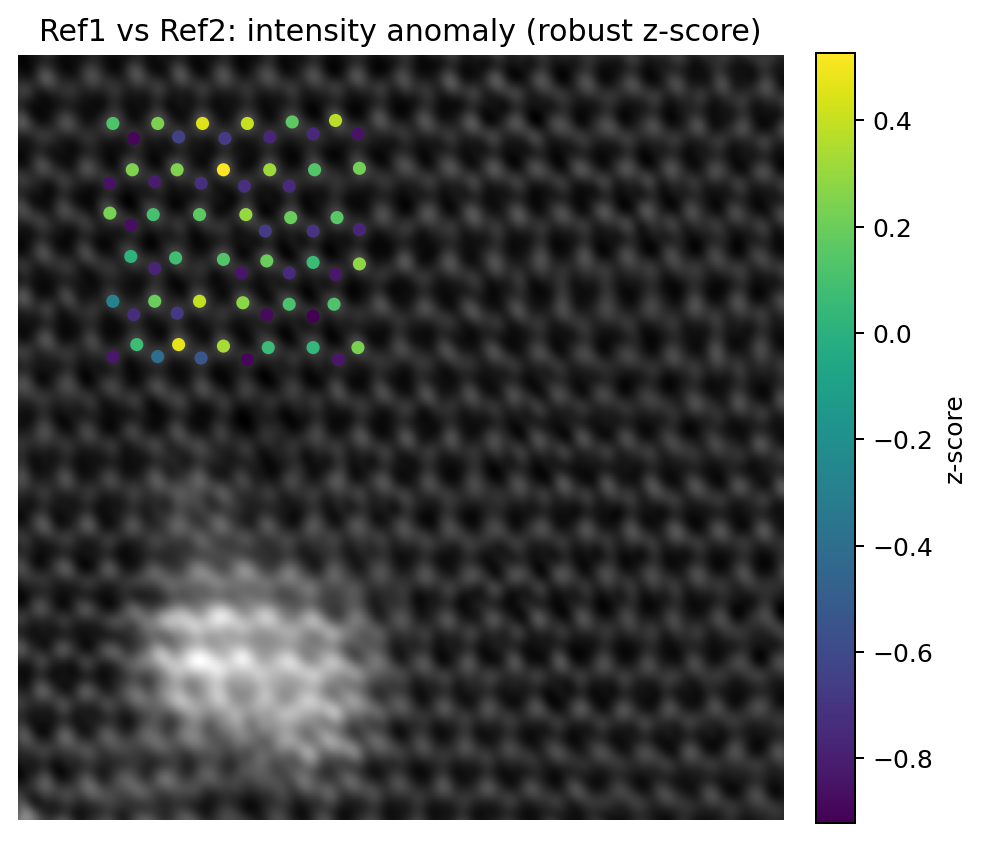

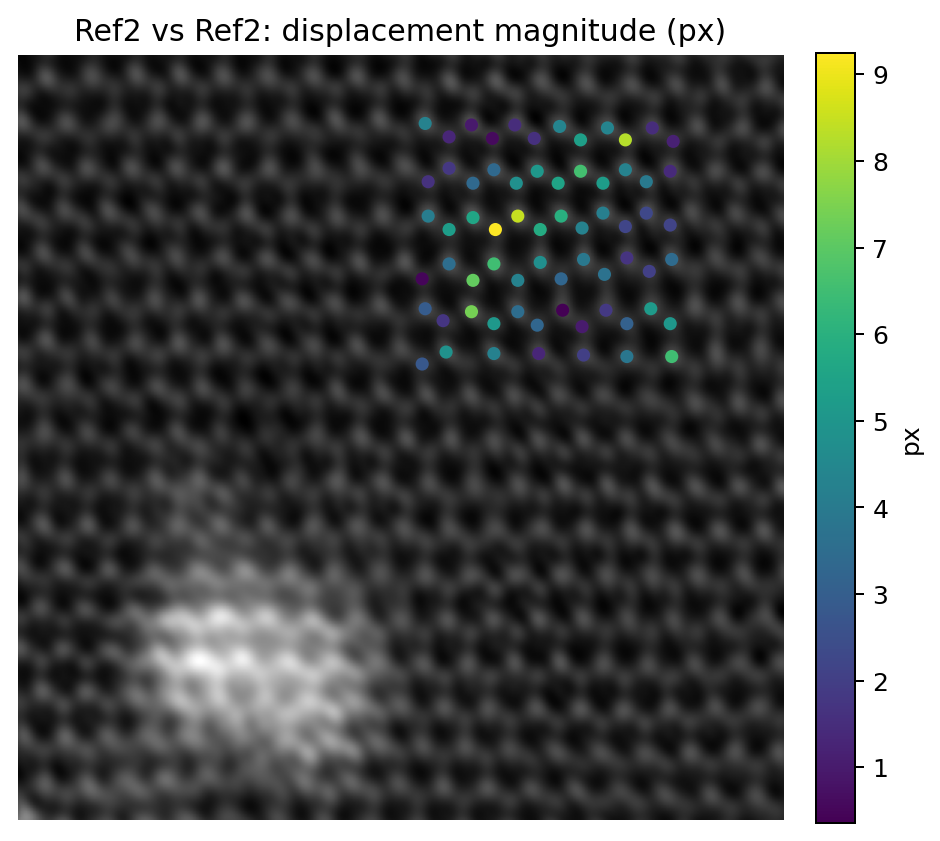

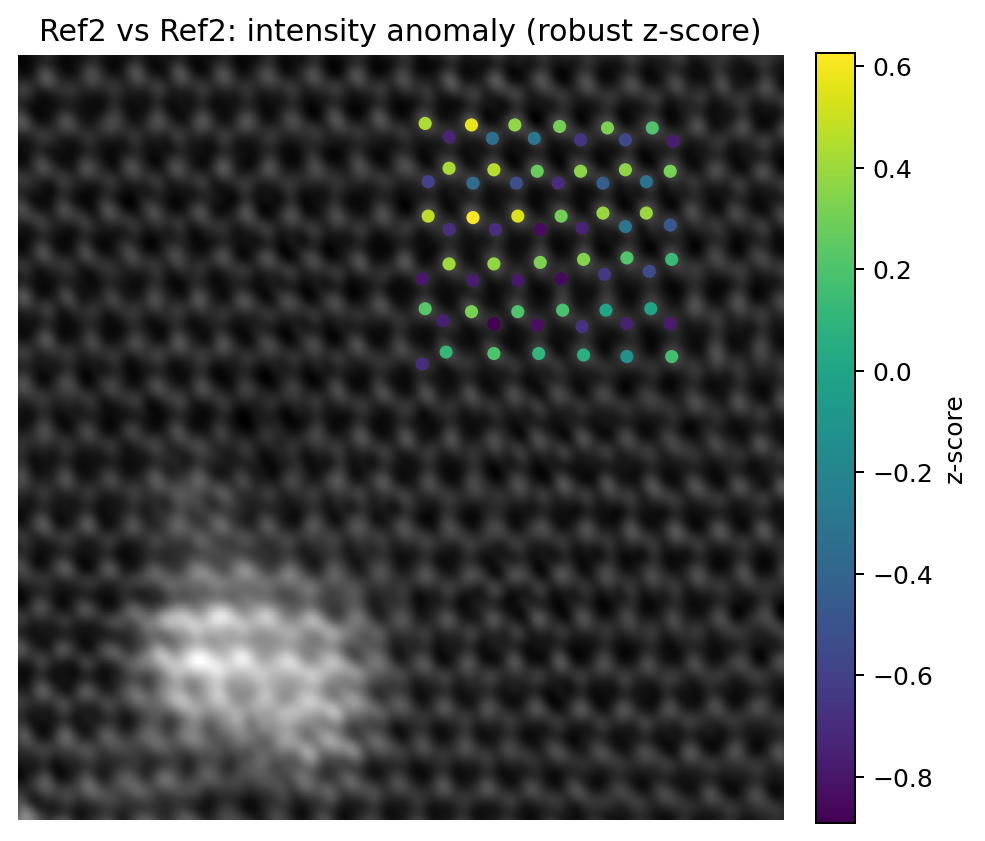

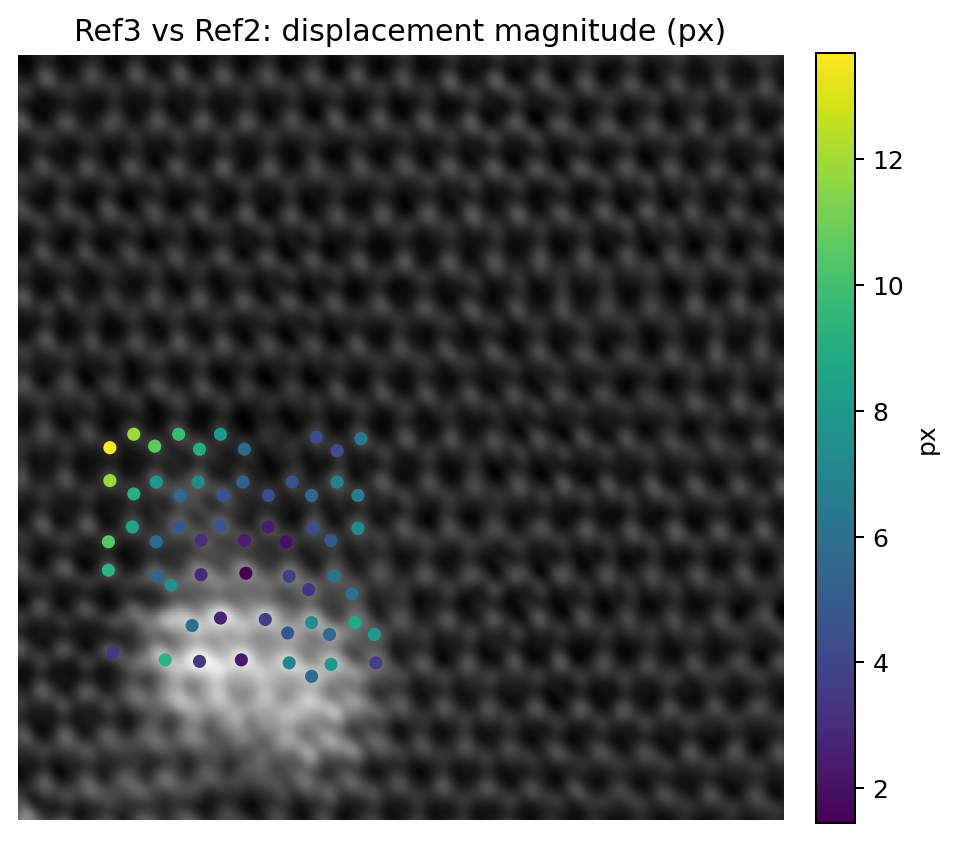

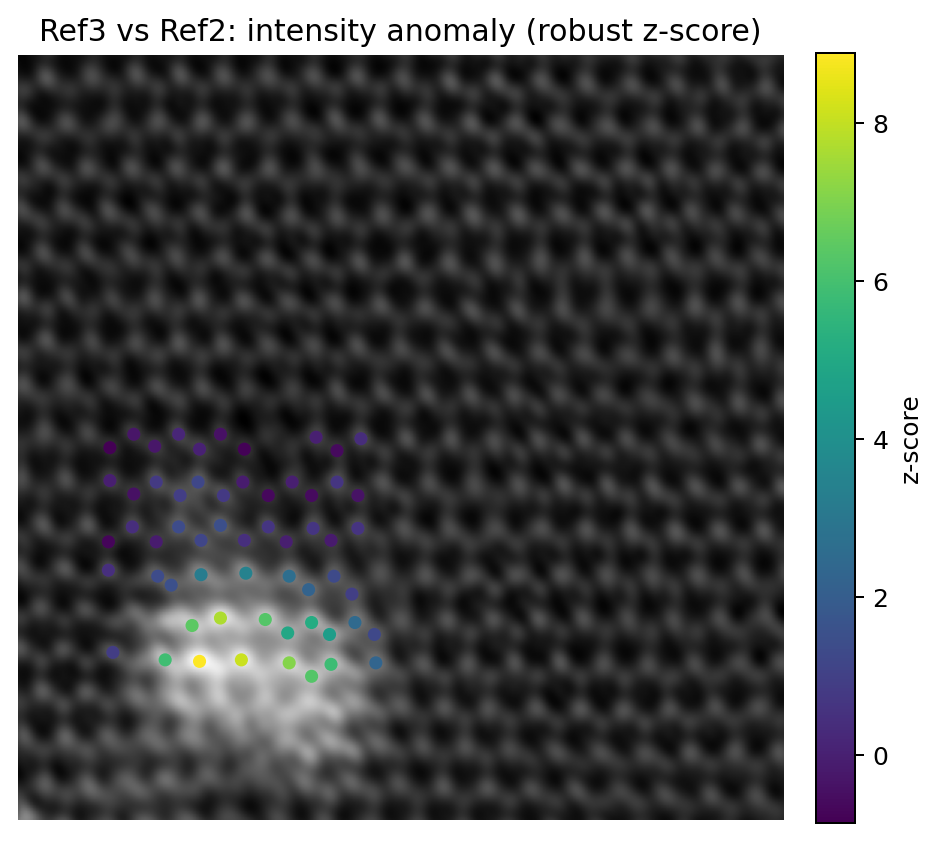

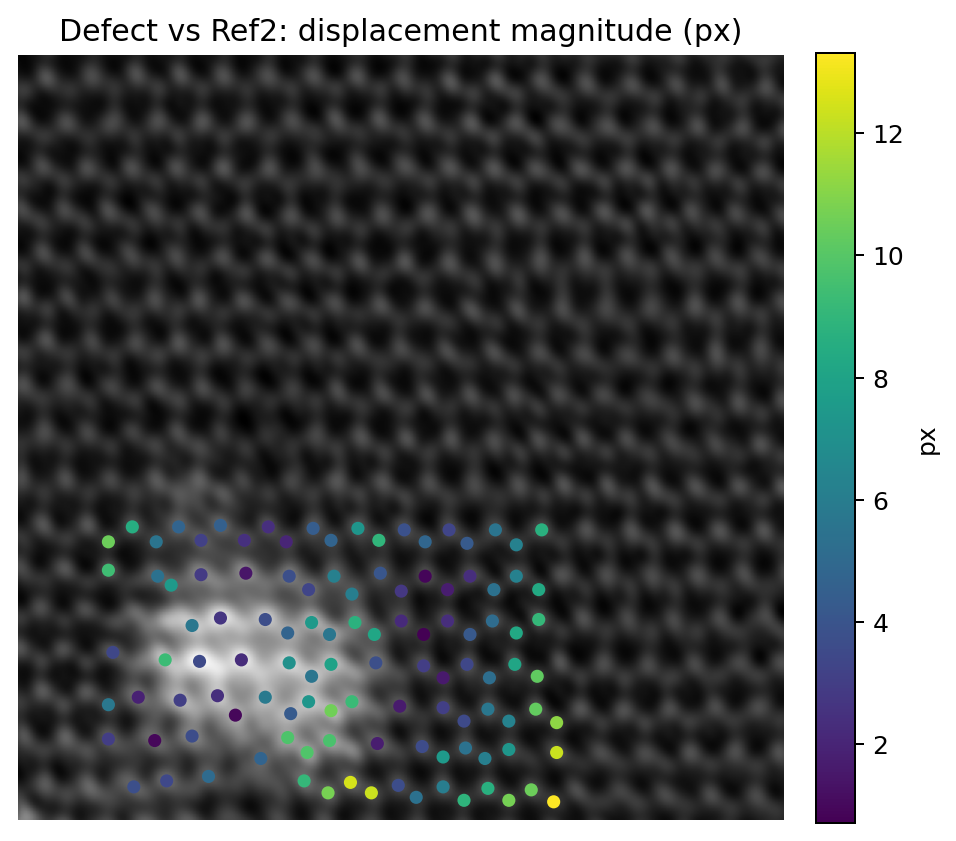

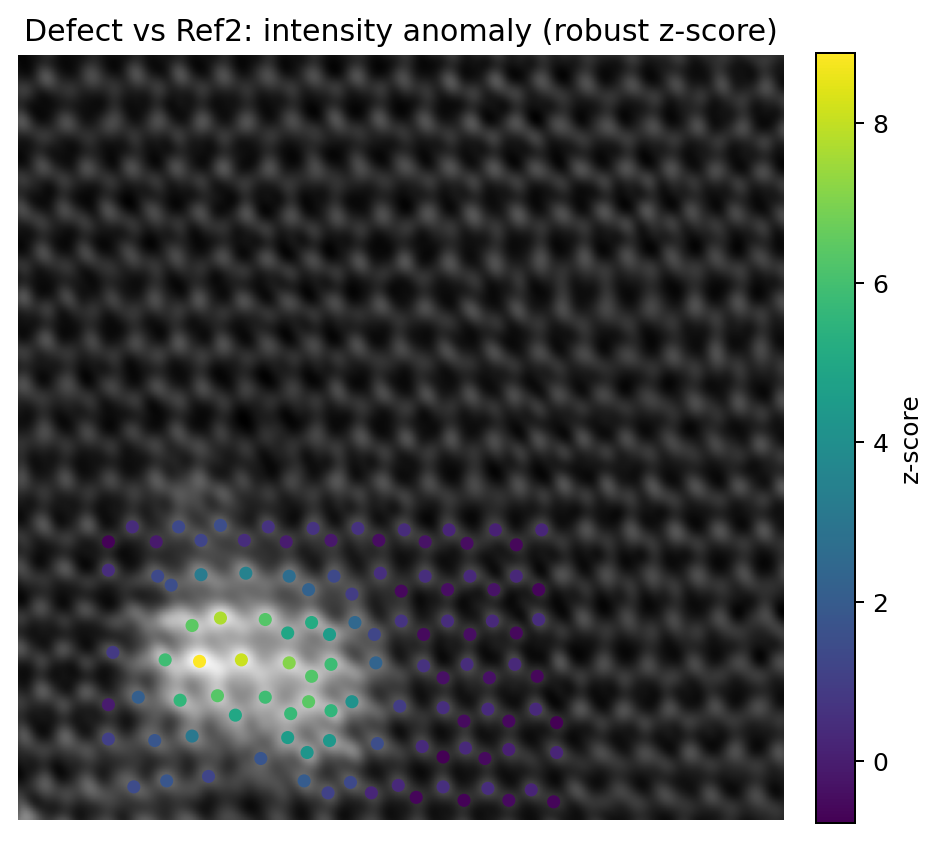


Geometry anomaly threshold (from best reference 95th percentile): 7.293254095346755 px

=== DEFECT ROI: flagged atoms (top 20 by displacement) ===


,row,col,disp_mag_px,zI,geom_anomaly,intensity_anomaly,any_anomaly
105,499.0,358.0,13.311781,-0.629820,True,False,True
39,486.0,222.0,12.496936,1.337684,True,False,True
78,466.0,360.0,12.308912,0.232706,True,False,True
81,493.0,236.0,12.305226,0.265988,True,False,True
109,446.0,360.0,11.152702,-0.775875,True,False,True
44,493.0,207.0,10.749699,1.132397,True,False,True
97,498.0,328.0,10.675948,-0.532995,True,False,True
13,438.0,209.0,10.602314,5.543343,True,True,True
107,325.0,60.0,10.476722,-0.719914,True,False,True
79,491.0,343.0,10.462699,0.192008,True,False,True


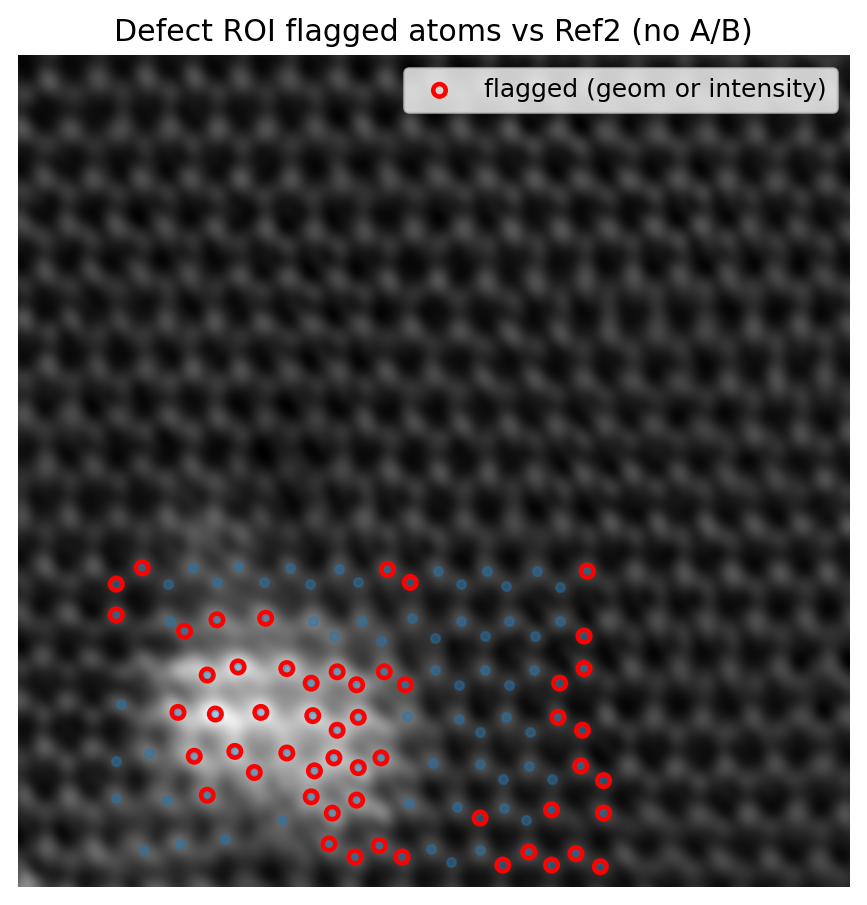


Done. If cross-ref displacement is low, your 'perfect' region is truly uniform.
If cross-ref displacement is high, your perfect region has drift/rotation/strain and you should pick a tighter ref ROI.


In [ ]:
# ============================================================
# COMPLETE REFERENCE-BASED ANALYSIS (NO FORCED A/B ASSIGNMENT)
# What this does (professor-style):
#  1) Define 3 "perfect" ROIs (Ref1/Ref2/Ref3) inside the crystalline region.
#  2) For each Ref ROI:
#       - estimate NN spacing
#       - build a reference lattice model (dominant axes + affine fit)
#       - compute "self-consistency" (displacement/strain/intensity stats)
#  3) Cross-check: apply Ref1 model to Ref2 and Ref3 (and vice versa)
#       - tells you whether "perfect region is actually perfect" / uniform.
#  4) Analyze a Defect ROI against each reference model:
#       - displacement magnitude map
#       - local strain maps (ε_rr, ε_cc, ε_rc)
#       - intensity anomaly map (robust z-score vs reference)
#  5) Flag atoms as: geometry-anomaly / intensity-anomaly (WITHOUT A/B chemistry)
#
# Inputs required:
#   nIm      : 2D image (float recommended)
#   allatoms : list/array of detected atom positions [row, col]
#   r        : peak radius (pixels)  (only used for intensity integration radius)
# Optional:
#   cal      : real_units_per_pixel (not needed for this analysis)
# ============================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.spatial import cKDTree
from matplotlib.patches import Rectangle

img = np.asarray(nIm, dtype=float)
H, W = img.shape
atoms = np.asarray(allatoms, dtype=float)  # [row,col]
all_tree = cKDTree(atoms)

# ----------------------------
# USER: set ROIs here (PIXELS)
# Put 3 reference boxes fully inside your best crystalline region.
# Put 1 defect box around suspicious region.
# Format: (r0, r1, c0, c1)
# ----------------------------
Ref_boxes = [
    (40, 220, 60, 240),   # Ref1
    (40, 220, 260, 440),  # Ref2
    (240, 420, 60, 240),  # Ref3
]
Def_box  = (300, 560, 60, 360)    # Defect ROI

# ----------------------------
# helpers
# ----------------------------
def in_box(rc, box):
    r0, r1, c0, c1 = box
    return (r0 <= rc[0] <= r1) and (c0 <= rc[1] <= c1)

def atoms_in_box(box):
    pts = np.array([a for a in atoms if in_box(a, box)], dtype=float)
    return pts

def mean_intensity_circle(img2d, row, col, rad=2):
    rr = int(round(row)); cc = int(round(col))
    rmin, rmax = max(0, rr-rad), min(img2d.shape[0], rr+rad+1)
    cmin, cmax = max(0, cc-rad), min(img2d.shape[1], cc+rad+1)
    Rs = np.arange(rmin, rmax)
    Cs = np.arange(cmin, cmax)
    C, R = np.meshgrid(Cs, Rs)
    mask = (R-row)**2 + (C-col)**2 <= rad*rad
    vals = img2d[R[mask], C[mask]]
    return float(vals.mean()) if vals.size else np.nan

def robust_z(x, ref):
    """robust z-score using median + IQR of ref"""
    x = np.asarray(x, dtype=float)
    ref = np.asarray(ref, dtype=float)
    med = float(np.nanmedian(ref))
    iqr = float(np.nanpercentile(ref, 75) - np.nanpercentile(ref, 25) + 1e-12)
    return (x - med) / iqr, med, iqr

# ----------------------------
# Build a lattice model from a reference ROI
#   model = {origin, u1, u2, s1, s2, A_aff, nn_spacing, I_ref_stats}
# ----------------------------
def build_lattice_model(ref_pts, name="Ref"):
    if len(ref_pts) < 25:
        raise ValueError(f"{name}: too few atoms in ROI ({len(ref_pts)}). Enlarge the box.")

    ref_tree = cKDTree(ref_pts)

    # NN spacing (pixels)
    d2, _ = ref_tree.query(ref_pts, k=2)
    nn_spacing = float(np.nanmedian(d2[:, 1]))

    # Collect 1st-shell neighbor vectors for direction finding
    k = 7
    dK, nnK = ref_tree.query(ref_pts, k=k)
    vecs = []
    for i in range(len(ref_pts)):
        c = ref_pts[i]
        nbrs = ref_pts[nnK[i][1:]]  # skip self
        for nb, dd in zip(nbrs, dK[i][1:]):
            if dd < 1.4 * nn_spacing:
                vecs.append(nb - c)  # [drow,dcol]
    vecs = np.asarray(vecs, dtype=float)

    # Find 2 dominant lattice directions using PCA on vec directions
    vn = vecs / (np.linalg.norm(vecs, axis=1, keepdims=True) + 1e-12)
    # fold sign: treat v and -v same
    vn = np.where(vn[:, [0]] < 0, -vn, vn)

    # PCA via SVD
    C = (vn - vn.mean(axis=0))
    _, _, Vt = np.linalg.svd(C, full_matrices=False)
    u1 = Vt[0]
    u2 = Vt[1]
    # Ensure u1/u2 are unit vectors
    u1 = u1 / (np.linalg.norm(u1) + 1e-12)
    u2 = u2 / (np.linalg.norm(u2) + 1e-12)

    origin = ref_pts.mean(axis=0)

    # Estimate spacing along axes
    s1 = float(np.nanmedian(np.abs(vecs @ u1)))
    s2 = float(np.nanmedian(np.abs(vecs @ u2)))
    if not np.isfinite(s1) or s1 < 1e-6: s1 = nn_spacing
    if not np.isfinite(s2) or s2 < 1e-6: s2 = nn_spacing

    # Grid coords (integer) for ref points
    proj1 = (ref_pts - origin) @ u1
    proj2 = (ref_pts - origin) @ u2
    g1 = np.round(proj1 / s1)
    g2 = np.round(proj2 / s2)

    # Affine fit: [g1 g2 1] -> [row col]
    G = np.vstack([g1, g2, np.ones_like(g1)]).T  # (N,3)
    A_aff, *_ = np.linalg.lstsq(G, ref_pts, rcond=None)  # (3,2)

    # Reference intensity distribution (disk-mean)
    rad_int = max(1, int(round(1.5 * r)))
    I_ref = np.array([mean_intensity_circle(img, rr, cc, rad=rad_int) for rr, cc in ref_pts], dtype=float)

    return dict(
        name=name,
        origin=origin, u1=u1, u2=u2, s1=s1, s2=s2,
        A_aff=A_aff, nn_spacing=nn_spacing,
        I_ref=I_ref, rad_int=rad_int
    )

def predict_from_grid(g1v, g2v, A_aff):
    Gv = np.vstack([g1v, g2v, np.ones_like(g1v)]).T
    return Gv @ A_aff

# ----------------------------
# Analyze any ROI against a given model
# ----------------------------
def analyze_roi(pts, model, roi_name="ROI"):
    pts = np.asarray(pts, dtype=float)
    if len(pts) < 10:
        return None

    origin = model["origin"]; u1=model["u1"]; u2=model["u2"]; s1=model["s1"]; s2=model["s2"]; A_aff=model["A_aff"]

    proj1 = (pts - origin) @ u1
    proj2 = (pts - origin) @ u2
    g1 = np.round(proj1 / s1)
    g2 = np.round(proj2 / s2)

    ideal = predict_from_grid(g1, g2, A_aff)
    disp = pts - ideal
    disp_mag = np.linalg.norm(disp, axis=1)

    # local strain via neighborhood affine fit
    tree = cKDTree(pts)
    R_loc = 1.6 * model["nn_spacing"]
    exx = np.full(len(pts), np.nan)
    eyy = np.full(len(pts), np.nan)
    exy = np.full(len(pts), np.nan)

    for i, p in enumerate(pts):
        nbr = tree.query_ball_point(p, r=R_loc)
        if len(nbr) < 6:
            continue
        P = pts[nbr] - p
        Q = ideal[nbr] - ideal[i]
        F_T, *_ = np.linalg.lstsq(Q, P, rcond=None)
        F = F_T.T
        eps = 0.5*(F + F.T) - np.eye(2)
        exx[i], eyy[i], exy[i] = eps[0,0], eps[1,1], eps[0,1]

    # intensity + robust anomaly vs ref intensity
    rad_int = model["rad_int"]
    I = np.array([mean_intensity_circle(img, rr, cc, rad=rad_int) for rr, cc in pts], dtype=float)
    zI, I_ref_med, I_ref_iqr = robust_z(I, model["I_ref"])

    # summary stats
    out = dict(
        roi=roi_name, model=model["name"],
        n=len(pts),
        disp_median=float(np.nanmedian(disp_mag)),
        disp_95=float(np.nanpercentile(disp_mag, 95)),
        strain_rr_median=float(np.nanmedian(exx)),
        strain_cc_median=float(np.nanmedian(eyy)),
        strain_rc_median=float(np.nanmedian(exy)),
        I_median=float(np.nanmedian(I)),
        zI_median=float(np.nanmedian(zI)),
        I_ref_median=float(I_ref_med),
        I_ref_iqr=float(I_ref_iqr)
    )

    # detailed arrays for plotting
    detail = dict(pts=pts, ideal=ideal, disp_mag=disp_mag, exx=exx, eyy=eyy, exy=exy, I=I, zI=zI)
    return out, detail

def scatter_overlay(detail, title, values, cmap_label):
    pts = detail["pts"]
    plt.figure(figsize=(6,6), dpi=180)
    plt.imshow(img, cmap="gray")
    sc = plt.scatter(pts[:,1], pts[:,0], c=values, s=18)
    plt.title(title)
    plt.axis("off")
    plt.colorbar(sc, fraction=0.046, pad=0.04, label=cmap_label)
    plt.show()

# ----------------------------
# Build three reference models
# ----------------------------
Ref_pts = [atoms_in_box(b) for b in Ref_boxes]
models = []
for i, pts in enumerate(Ref_pts, start=1):
    models.append(build_lattice_model(pts, name=f"Ref{i}"))

# defect points
Def_pts = atoms_in_box(Def_box)

# ----------------------------
# ROI overview plot
# ----------------------------
plt.figure(figsize=(6,6), dpi=180)
plt.imshow(img, cmap="gray")
colors = ["lime", "cyan", "yellow"]
for i, b in enumerate(Ref_boxes):
    plt.gca().add_patch(Rectangle((b[2], b[0]), b[3]-b[2], b[1]-b[0], fill=False, ec=colors[i], lw=2))
    plt.text(b[2], b[0]-5, f"Ref{i+1}", color=colors[i], fontsize=10)
plt.gca().add_patch(Rectangle((Def_box[2], Def_box[0]), Def_box[3]-Def_box[2], Def_box[1]-Def_box[0], fill=False, ec="red", lw=2))
plt.text(Def_box[2], Def_box[0]-5, "Defect", color="red", fontsize=10)
plt.title("ROIs: 3 reference regions + defect region")
plt.axis("off")
plt.show()

# ----------------------------
# Self-consistency: each Ref ROI analyzed by its own model
# ----------------------------
summaries = []
details_store = {}

for i, m in enumerate(models, start=1):
    out, det = analyze_roi(Ref_pts[i-1], m, roi_name=f"Ref{i}")
    summaries.append(out)
    details_store[(f"Ref{i}", m["name"])] = det

# ----------------------------
# Cross-check: apply Ref1 model to Ref2/Ref3, etc.
# This answers: "Is the perfect region uniform?"
# ----------------------------
for i, m in enumerate(models, start=1):
    for j, pts in enumerate(Ref_pts, start=1):
        out, det = analyze_roi(pts, m, roi_name=f"Ref{j}")
        summaries.append(out)
        details_store[(f"Ref{j}", m["name"])] = det

# ----------------------------
# Defect analysis against each reference model
# ----------------------------
for m in models:
    out, det = analyze_roi(Def_pts, m, roi_name="Defect")
    summaries.append(out)
    details_store[("Defect", m["name"])] = det

df = pd.DataFrame(summaries)
print("\n=== SUMMARY TABLE (lower displacement/strain in refs = better 'perfect') ===")
display(df.sort_values(["roi","model"]).reset_index(drop=True))

# ----------------------------
# Prof-style interpretation helpers
#  - If Ref2 analyzed with Ref1 has low displacement -> lattice is uniform across refs.
#  - If cross-ref displacement is high -> your "perfect" region is not uniform
#    (rotation gradient, scan distortion, strain gradient, thickness gradient).
# ----------------------------
print("\n=== QUICK CHECK: Reference uniformity (cross-ref) ===")
ref_only = df[df["roi"].str.startswith("Ref")].copy()
pivot = ref_only.pivot_table(index="roi", columns="model", values="disp_median")
display(pivot)

# ----------------------------
# Plots: show metrics for BOTH reference and defect
# Choose the "best" reference model = the one with lowest self-consistency disp in its own ROI
# ----------------------------
self_disp = df[(df["roi"].str.startswith("Ref")) & (df["roi"] == df["model"])][["roi","disp_median"]]
best_ref = self_disp.sort_values("disp_median").iloc[0]["roi"]  # e.g. "Ref1"
best_model_name = best_ref  # model names are "Ref1","Ref2","Ref3"
print(f"\nBest reference model (most self-consistent): {best_model_name}")

# Plot Ref1/Ref2/Ref3 and Defect using best model
for roi_name in ["Ref1","Ref2","Ref3","Defect"]:
    det = details_store.get((roi_name, best_model_name), None)
    if det is None:
        continue

    scatter_overlay(det, f"{roi_name} vs {best_model_name}: displacement magnitude (px)", det["disp_mag"], "px")
    scatter_overlay(det, f"{roi_name} vs {best_model_name}: intensity anomaly (robust z-score)", det["zI"], "z-score")

# Local strain for defect (best model)
det_def = details_store.get(("Defect", best_model_name), None)
if det_def is not None:
    m = np.isfinite(det_def["exx"])
    if np.any(m):
        scatter_overlay(
            dict(pts=det_def["pts"][m]),
            f"Defect vs {best_model_name}: local strain ε_rr",
            det_def["exx"][m],
            "strain"
        )
        scatter_overlay(
            dict(pts=det_def["pts"][m]),
            f"Defect vs {best_model_name}: local strain ε_cc",
            det_def["eyy"][m],
            "strain"
        )
        scatter_overlay(
            dict(pts=det_def["pts"][m]),
            f"Defect vs {best_model_name}: local strain ε_rc",
            det_def["exy"][m],
            "strain"
        )

# ----------------------------
# Flag "anomalous atoms" WITHOUT A/B:
#   - geometry anomaly: displacement > 95th percentile of best reference ROI
#   - intensity anomaly: |zI| > 3 (robust)
# ----------------------------
det_ref_best = details_store.get((best_model_name, best_model_name), None)
det_def_best = details_store.get(("Defect", best_model_name), None)

if det_ref_best is not None and det_def_best is not None:
    disp_thr = float(np.nanpercentile(det_ref_best["disp_mag"], 95))
    print("\nGeometry anomaly threshold (from best reference 95th percentile):", disp_thr, "px")

    geom_bad = det_def_best["disp_mag"] > disp_thr
    inten_bad = np.abs(det_def_best["zI"]) > 3.0

    bad_any = geom_bad | inten_bad
    flagged = pd.DataFrame({
        "row": det_def_best["pts"][:,0],
        "col": det_def_best["pts"][:,1],
        "disp_mag_px": det_def_best["disp_mag"],
        "zI": det_def_best["zI"],
        "geom_anomaly": geom_bad,
        "intensity_anomaly": inten_bad,
        "any_anomaly": bad_any
    })

    print("\n=== DEFECT ROI: flagged atoms (top 20 by displacement) ===")
    display(flagged.sort_values("disp_mag_px", ascending=False).head(20))

    # visualize flagged points
    plt.figure(figsize=(6,6), dpi=180)
    plt.imshow(img, cmap="gray")
    plt.scatter(det_def_best["pts"][:,1], det_def_best["pts"][:,0], s=12, alpha=0.4)  # all
    plt.scatter(det_def_best["pts"][bad_any,1], det_def_best["pts"][bad_any,0], s=25, edgecolor="red",
                facecolor="none", linewidth=1.8, label="flagged (geom or intensity)")
    plt.title(f"Defect ROI flagged atoms vs {best_model_name} (no A/B)")
    plt.axis("off")
    plt.legend(loc="upper right")
    plt.show()

print("\nDone. If cross-ref displacement is low, your 'perfect' region is truly uniform.")
print("If cross-ref displacement is high, your perfect region has drift/rotation/strain and you should pick a tighter ref ROI.")


Atoms per Ref ROI: [64, 67, 69]


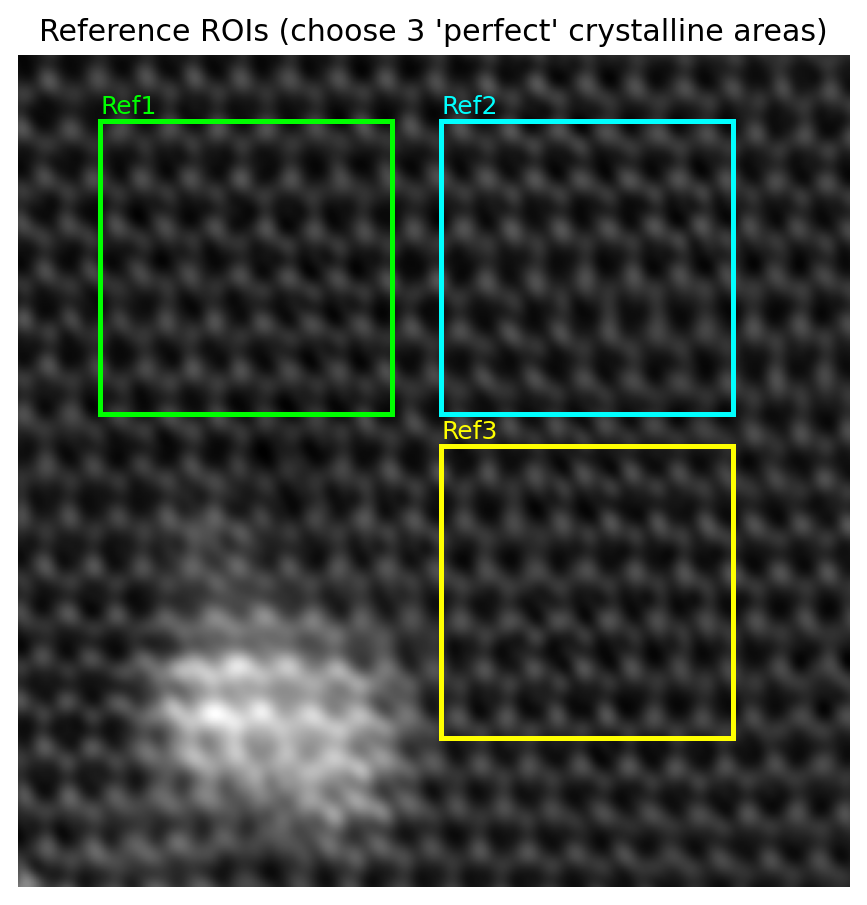

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.spatial import cKDTree
from matplotlib.patches import Rectangle

img = np.asarray(nIm, dtype=float)
H, W = img.shape
atoms = np.asarray(allatoms, dtype=float)  # [row,col]

# ---- Set 3 "perfect" ROIs here (r0,r1,c0,c1) in pixels
Ref_boxes = [
    (40, 220, 50, 230),   # Ref1
    (40, 220, 260, 440),  # Ref2
    (240, 420, 260, 440),  # Ref3
]

def in_box(rc, box):
    r0, r1, c0, c1 = box
    return (r0 <= rc[0] <= r1) and (c0 <= rc[1] <= c1)

def atoms_in_box(box):
    return np.array([a for a in atoms if in_box(a, box)], dtype=float)

Ref_pts = [atoms_in_box(b) for b in Ref_boxes]
print("Atoms per Ref ROI:", [len(p) for p in Ref_pts])

# Preview
plt.figure(figsize=(6,6), dpi=180)
plt.imshow(img, cmap="gray")
colors = ["lime", "cyan", "yellow"]
for i, b in enumerate(Ref_boxes):
    plt.gca().add_patch(Rectangle((b[2], b[0]), b[3]-b[2], b[1]-b[0], fill=False, ec=colors[i], lw=2))
    plt.text(b[2], b[0]-5, f"Ref{i+1}", color=colors[i], fontsize=10)
plt.axis("off")
plt.title("Reference ROIs (choose 3 'perfect' crystalline areas)")
plt.show()


In [ ]:
def mean_intensity_circle(img2d, row, col, rad=2):
    rr = int(round(row)); cc = int(round(col))
    rmin, rmax = max(0, rr-rad), min(img2d.shape[0], rr+rad+1)
    cmin, cmax = max(0, cc-rad), min(img2d.shape[1], cc+rad+1)
    Rs = np.arange(rmin, rmax)
    Cs = np.arange(cmin, cmax)
    C, R = np.meshgrid(Cs, Rs)
    mask = (R-row)**2 + (C-col)**2 <= rad*rad
    vals = img2d[R[mask], C[mask]]
    return float(vals.mean()) if vals.size else np.nan


In [ ]:
def build_lattice_model(ref_pts, img, r, name="Ref"):
    ref_pts = np.asarray(ref_pts, dtype=float)
    if len(ref_pts) < 25:
        raise ValueError(f"{name}: too few atoms ({len(ref_pts)}). Enlarge ROI.")

    ref_tree = cKDTree(ref_pts)

    # 1) NN spacing (pixels)
    d2, _ = ref_tree.query(ref_pts, k=2)
    nn_spacing = float(np.nanmedian(d2[:, 1]))

    # 2) Collect first-shell neighbor vectors
    k = 7
    dK, nnK = ref_tree.query(ref_pts, k=k)
    vecs = []
    for i in range(len(ref_pts)):
        c = ref_pts[i]
        nbrs = ref_pts[nnK[i][1:]]
        for nb, dd in zip(nbrs, dK[i][1:]):
            if dd < 1.4 * nn_spacing:
                vecs.append(nb - c)  # [drow,dcol]
    vecs = np.asarray(vecs, dtype=float)

    # 3) Dominant lattice directions via PCA on unit vectors
    vn = vecs / (np.linalg.norm(vecs, axis=1, keepdims=True) + 1e-12)
    vn = np.where(vn[:, [0]] < 0, -vn, vn)  # fold sign
    C = vn - vn.mean(axis=0)
    _, _, Vt = np.linalg.svd(C, full_matrices=False)
    u1 = Vt[0] / (np.linalg.norm(Vt[0]) + 1e-12)
    u2 = Vt[1] / (np.linalg.norm(Vt[1]) + 1e-12)

    origin = ref_pts.mean(axis=0)

    # 4) Spacing along axes
    s1 = float(np.nanmedian(np.abs(vecs @ u1)))
    s2 = float(np.nanmedian(np.abs(vecs @ u2)))
    if not np.isfinite(s1) or s1 < 1e-6: s1 = nn_spacing
    if not np.isfinite(s2) or s2 < 1e-6: s2 = nn_spacing

    # 5) Assign integer grid coords
    proj1 = (ref_pts - origin) @ u1
    proj2 = (ref_pts - origin) @ u2
    g1 = np.round(proj1 / s1)
    g2 = np.round(proj2 / s2)

    # 6) Affine fit: [g1 g2 1] -> [row col]
    G = np.vstack([g1, g2, np.ones_like(g1)]).T
    A_aff, *_ = np.linalg.lstsq(G, ref_pts, rcond=None)

    # 7) Reference intensity baseline
    rad_int = max(1, int(round(1.5 * r)))
    I_ref = np.array([mean_intensity_circle(img, rr, cc, rad=rad_int) for rr, cc in ref_pts], dtype=float)

    return {
        "name": name,
        "origin": origin,
        "u1": u1, "u2": u2,
        "s1": s1, "s2": s2,
        "A_aff": A_aff,
        "nn_spacing": nn_spacing,
        "I_ref": I_ref,
        "rad_int": rad_int
    }

def predict_from_grid(g1v, g2v, A_aff):
    Gv = np.vstack([g1v, g2v, np.ones_like(g1v)]).T
    return Gv @ A_aff


In [ ]:
def validate_roi_against_model(pts, model, img, roi_name="ROI"):
    pts = np.asarray(pts, dtype=float)
    origin = model["origin"]; u1=model["u1"]; u2=model["u2"]; s1=model["s1"]; s2=model["s2"]; A_aff=model["A_aff"]

    proj1 = (pts - origin) @ u1
    proj2 = (pts - origin) @ u2
    g1 = np.round(proj1 / s1)
    g2 = np.round(proj2 / s2)

    ideal = predict_from_grid(g1, g2, A_aff)
    disp = pts - ideal
    disp_mag = np.linalg.norm(disp, axis=1)

    # intensity baseline for THIS roi (not z-scored here; just compare stats)
    rad_int = model["rad_int"]
    I = np.array([mean_intensity_circle(img, rr, cc, rad=rad_int) for rr, cc in pts], dtype=float)

    return {
        "roi": roi_name,
        "model": model["name"],
        "n": len(pts),
        "disp_median_px": float(np.nanmedian(disp_mag)),
        "disp_95_px": float(np.nanpercentile(disp_mag, 95)),
        "nn_spacing_px(model)": float(model["nn_spacing"]),
        "I_median": float(np.nanmedian(I)),
        "I_IQR": float(np.nanpercentile(I,75) - np.nanpercentile(I,25))
    }, disp_mag, I

# Build models from each ref ROI
models = []
for i, pts in enumerate(Ref_pts, start=1):
    models.append(build_lattice_model(pts, img, r=r, name=f"Ref{i}"))

# Evaluate every ROI with every model (self + cross)
rows = []
disp_store = {}
for i, pts in enumerate(Ref_pts, start=1):
    for m in models:
        out, disp_mag, I = validate_roi_against_model(pts, m, img, roi_name=f"Ref{i}")
        rows.append(out)
        disp_store[(f"Ref{i}", m["name"])] = disp_mag

df_val = pd.DataFrame(rows)
display(df_val.sort_values(["roi","model"]).reset_index(drop=True))

print("\n=== QUICK CHECK: Reference uniformity (cross-ref) ===")
pivot = df_val.pivot_table(index="roi", columns="model", values="disp_median_px")
display(pivot)

# Choose best reference model = lowest self median displacement
diag = df_val[df_val["roi"] == df_val["model"]][["roi","disp_median_px"]].copy()
best_ref = diag.sort_values("disp_median_px").iloc[0]["roi"]
print("Best reference model (most self-consistent):", best_ref)


,roi,model,n,disp_median_px,disp_95_px,nn_spacing_px(model),I_median,I_IQR
0,Ref1,Ref1,64,4.261724,7.990152,17.000000,0.265365,0.078322
1,Ref1,Ref2,64,9.573051,16.498917,16.643317,0.265365,0.078322
2,Ref1,Ref3,64,11.719839,17.136843,16.643317,0.265365,0.078322
3,Ref2,Ref1,67,11.953596,18.804668,17.000000,0.260083,0.080609
4,Ref2,Ref2,67,3.839021,7.293254,16.643317,0.260083,0.080609
5,Ref2,Ref3,67,5.945944,10.296923,16.643317,0.260083,0.080609
6,Ref3,Ref1,69,13.343010,18.136932,17.000000,0.263980,0.072188
7,Ref3,Ref2,69,8.106189,16.042144,16.643317,0.263980,0.072188
8,Ref3,Ref3,69,4.029471,6.837714,16.643317,0.263980,0.072188



=== QUICK CHECK: Reference uniformity (cross-ref) ===


model,Ref1,Ref2,Ref3
roi,,,
Ref1,4.261724,9.573051,11.719839
Ref2,11.953596,3.839021,5.945944
Ref3,13.343010,8.106189,4.029471


Best reference model (most self-consistent): Ref2


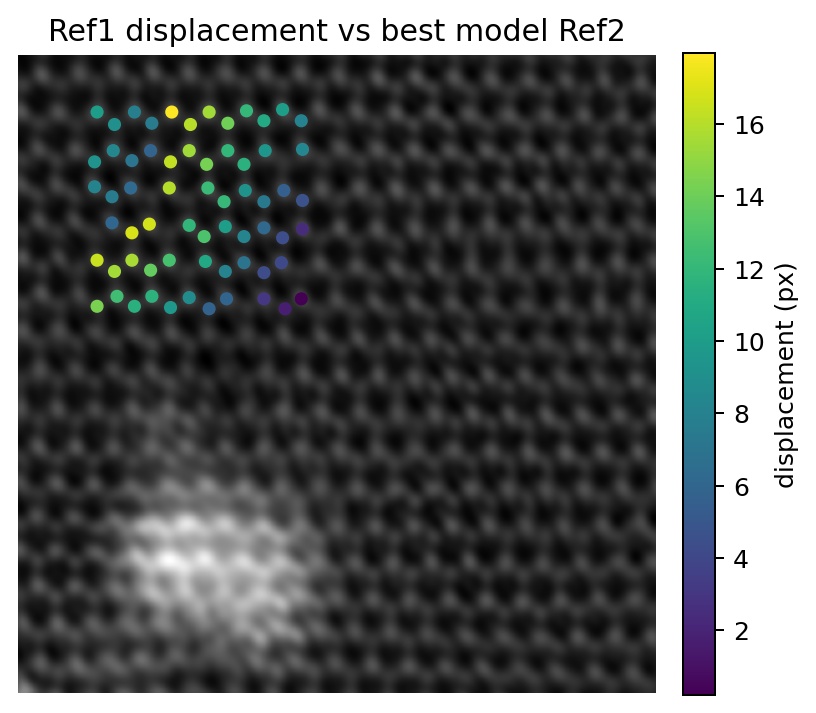

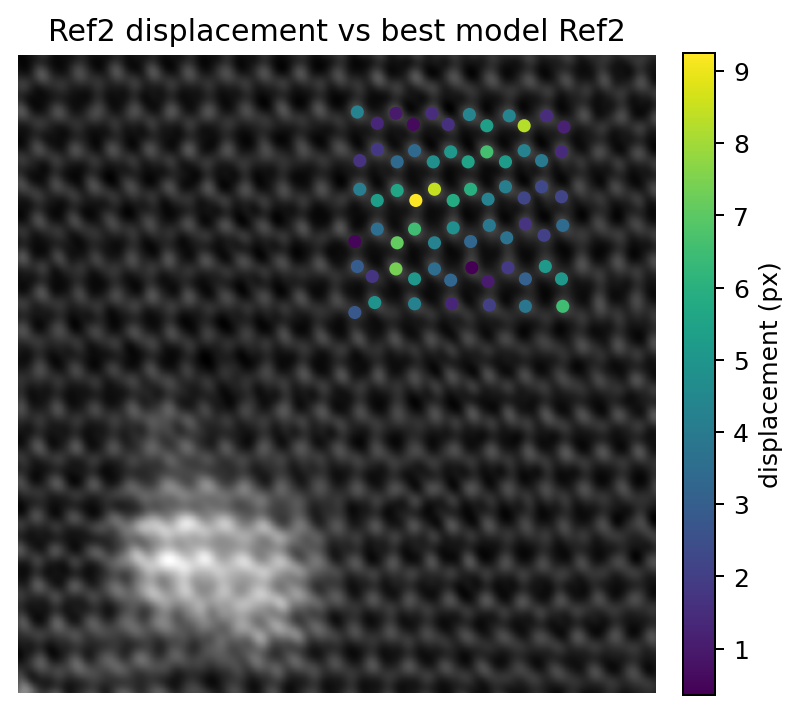

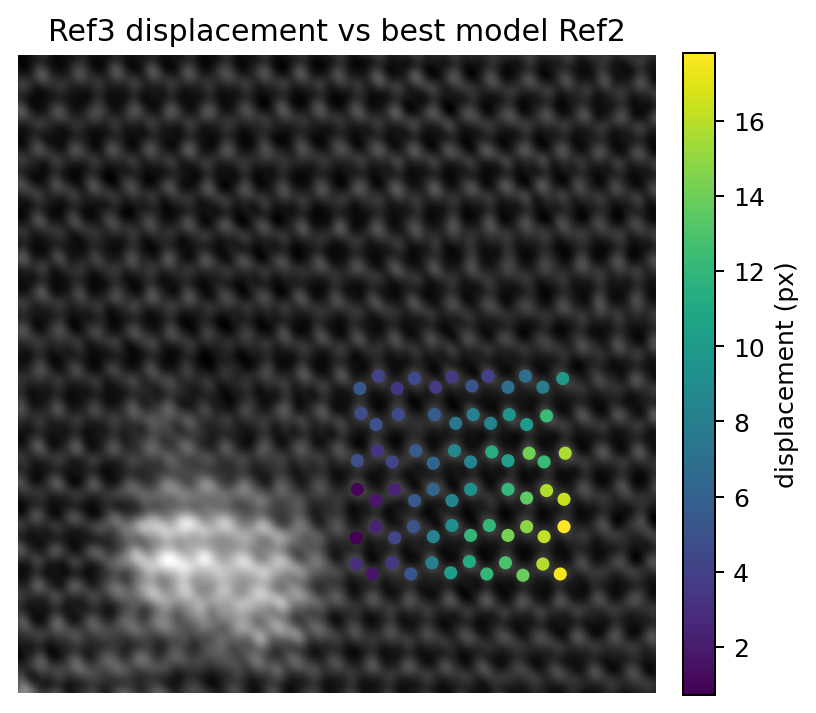

In [ ]:
best_model = [m for m in models if m["name"] == best_ref][0]

def plot_disp_map(pts, disp_mag, title):
    pts = np.asarray(pts, dtype=float)
    plt.figure(figsize=(5,5), dpi=180)
    plt.imshow(img, cmap="gray")
    sc = plt.scatter(pts[:,1], pts[:,0], c=disp_mag, s=18)
    plt.title(title)
    plt.axis("off")
    plt.colorbar(sc, fraction=0.046, pad=0.04, label="displacement (px)")
    plt.show()

for i, pts in enumerate(Ref_pts, start=1):
    disp_mag = disp_store[(f"Ref{i}", best_model["name"])]
    plot_disp_map(pts, disp_mag, f"Ref{i} displacement vs best model {best_model['name']}")


### Displacement Maps for all Reference ROI vs. Reference Model Combinations

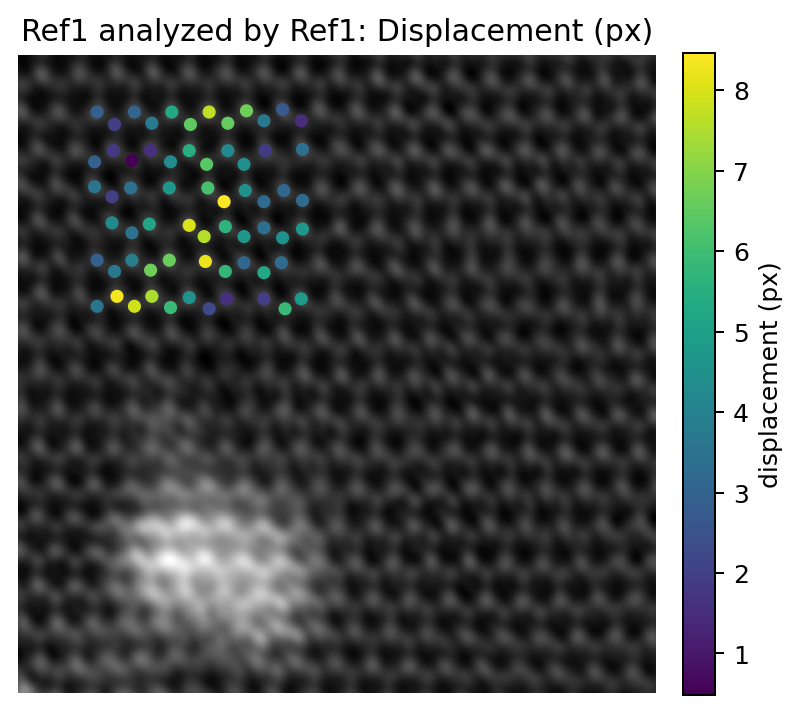

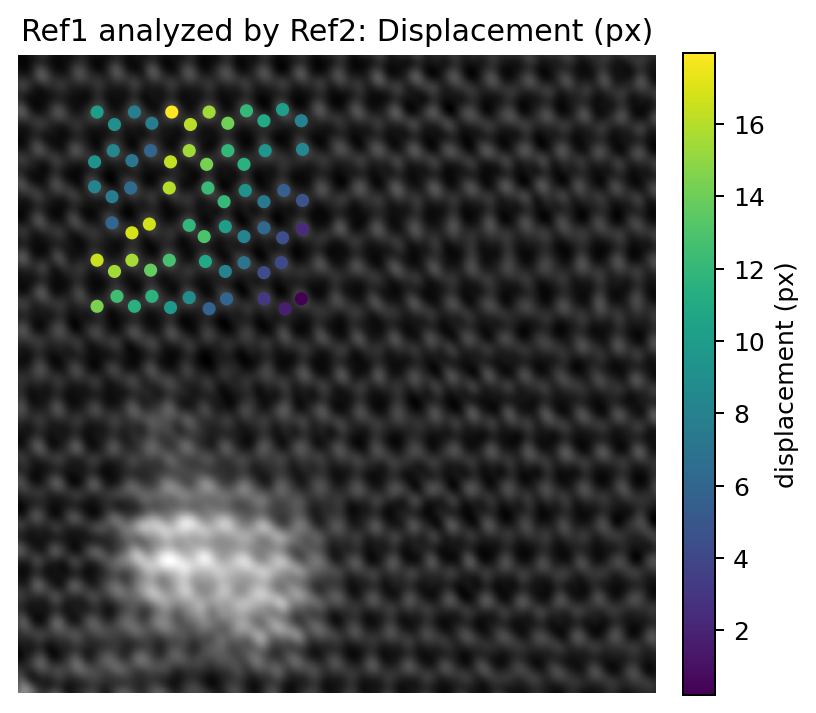

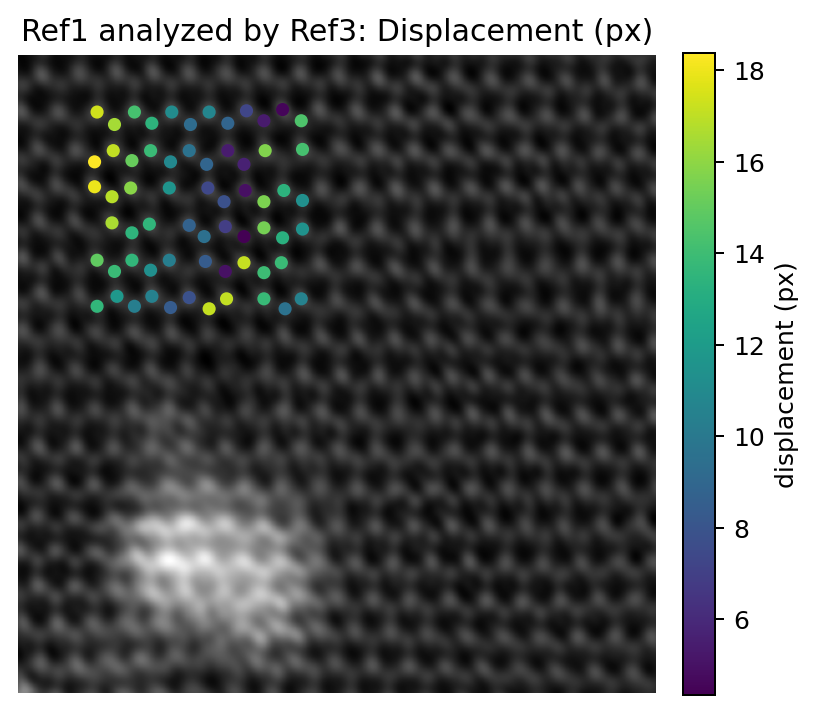

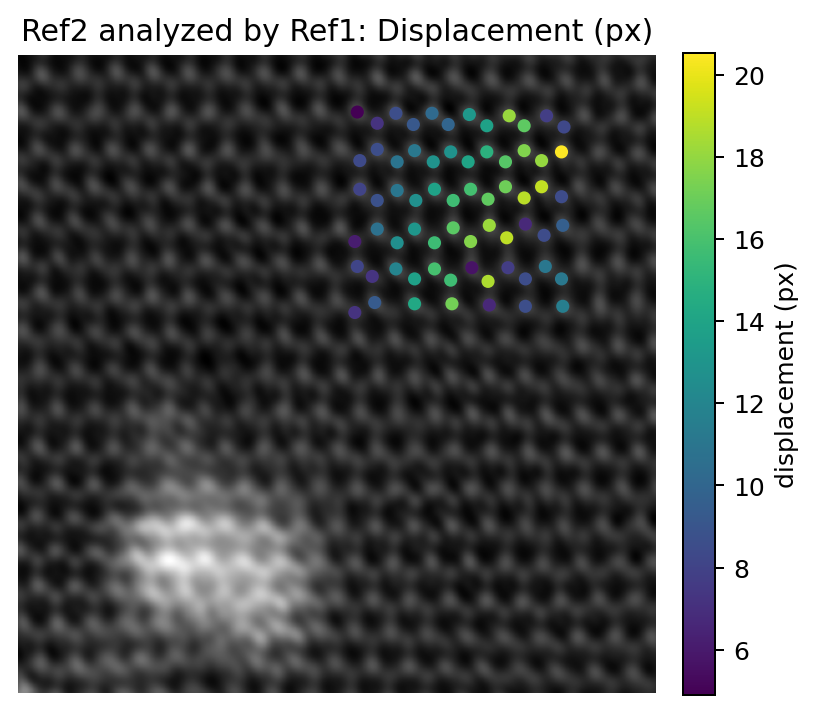

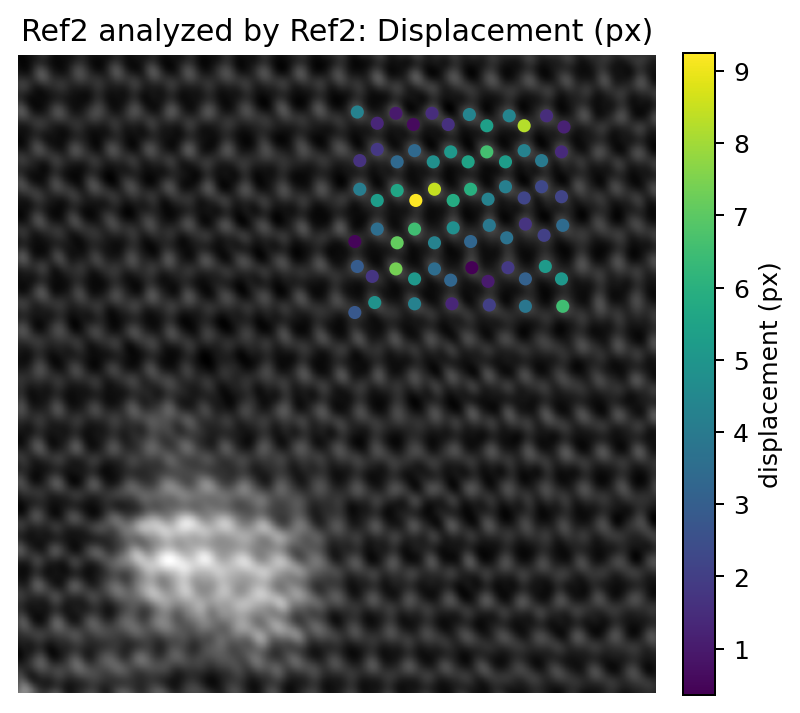

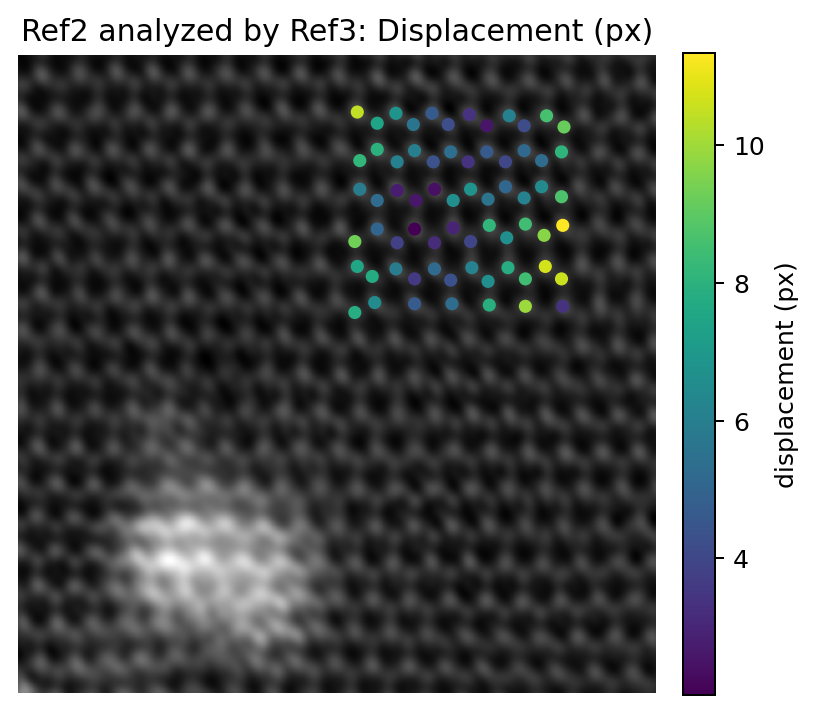

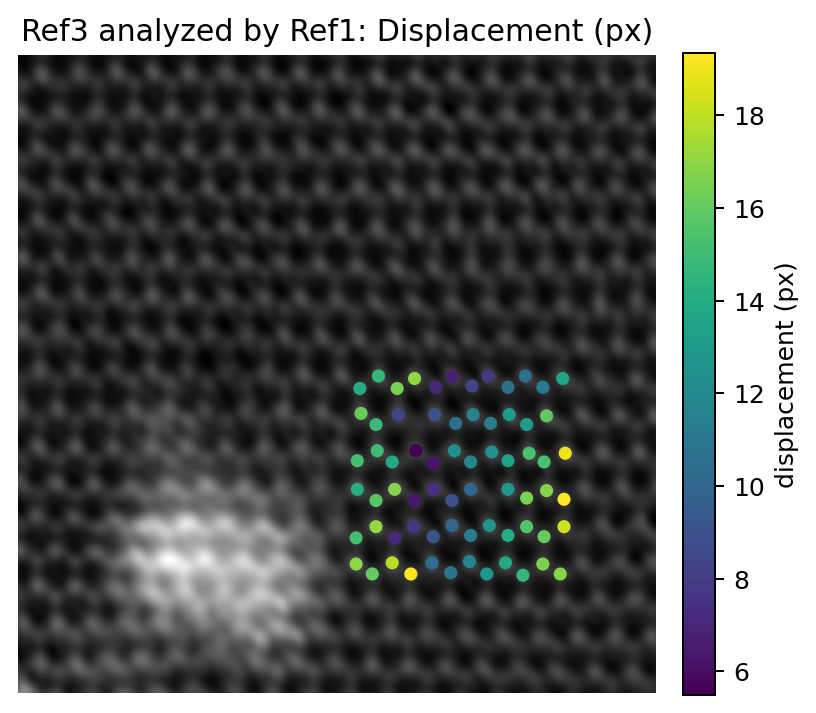

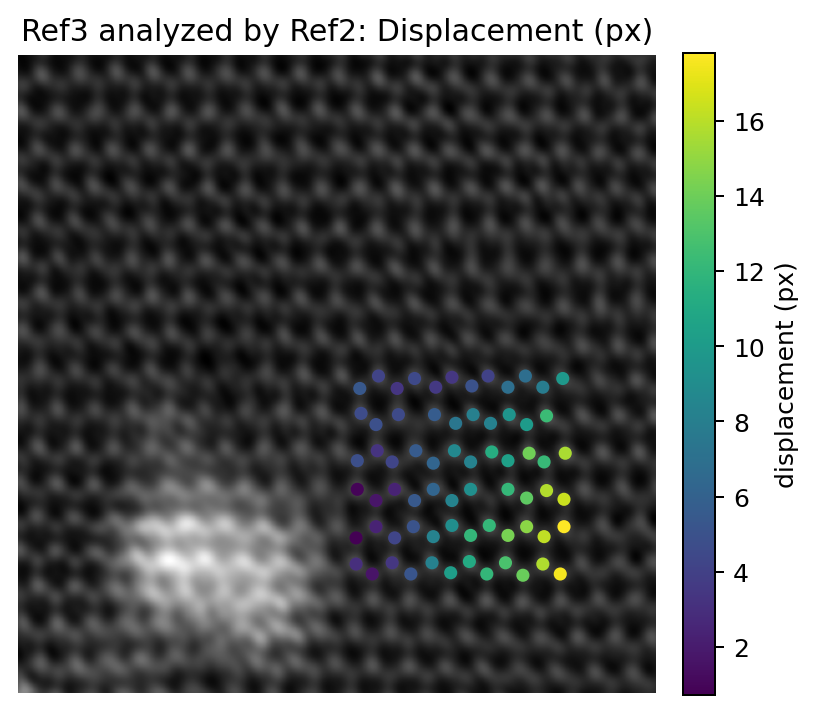

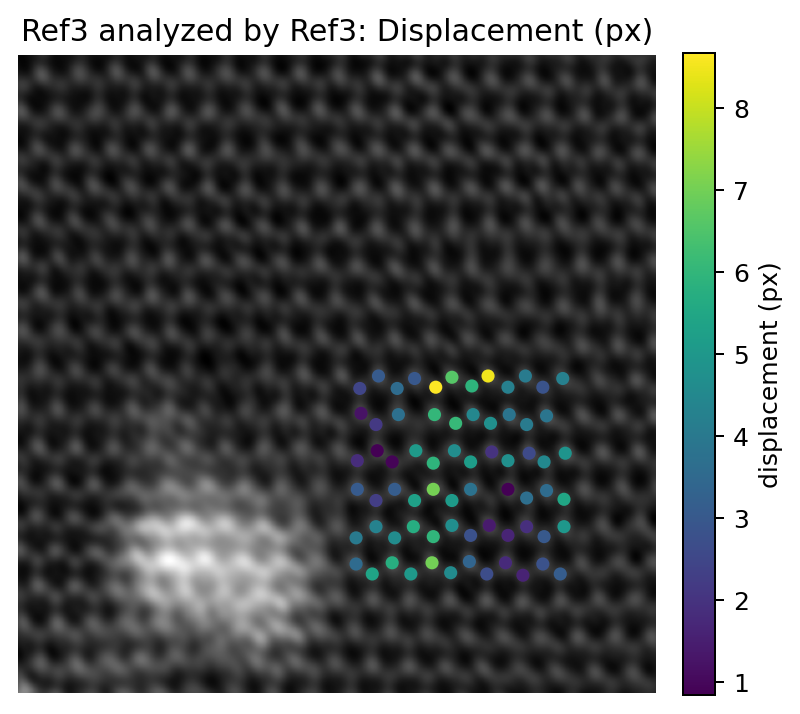

In [ ]:
# Iterate through the pivot table to generate displacement maps for each combination
for roi_name in pivot.index:
    for model_name in pivot.columns:
        # Determine the index of the current ROI to get its points from Ref_pts
        # Assumes ROI names are 'Ref1', 'Ref2', etc.
        roi_idx = int(roi_name.replace("Ref", "")) - 1
        current_pts = Ref_pts[roi_idx]

        # Retrieve the displacement magnitudes for this specific (ROI, Model) pair
        disp_mag_array = disp_store[(roi_name, model_name)]

        # Generate and display the displacement map
        plot_disp_map(current_pts, disp_mag_array, f"{roi_name} analyzed by {model_name}: Displacement (px)")


In [ ]:
This is after chosing best local region ref2 to compare allover the image

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial import cKDTree

img = np.asarray(nIm, dtype=float)
H, W = img.shape
atoms = np.asarray(allatoms, dtype=float)  # [row,col]

# ---- pick Ref2 model from your earlier reference-validation output
# models = [Ref1_model, Ref2_model, Ref3_model]
ref2_model = [m for m in models if m["name"] == "Ref2"][0]

# Convenience
origin = ref2_model["origin"]
u1, u2 = ref2_model["u1"], ref2_model["u2"]
s1, s2 = ref2_model["s1"], ref2_model["s2"]
A_aff = ref2_model["A_aff"]
nn_spacing = ref2_model["nn_spacing"]

print("Using Ref2 model:")
print("  nn_spacing(px):", nn_spacing)
print("  s1,s2(px):", s1, s2)
print("  u1,u2:", u1, u2)

def predict_from_grid(g1v, g2v, A_aff):
    Gv = np.vstack([g1v, g2v, np.ones_like(g1v)]).T
    return Gv @ A_aff


Using Ref2 model:
  nn_spacing(px): 16.64331697709324
  s1,s2(px): 14.236533126951691 9.585335803681335
  u1,u2: [0.03037409 0.9995386 ] [-0.9995386   0.03037409]


In [ ]:
# Project all atoms into Ref2 lattice coordinates
proj1 = (atoms - origin) @ u1
proj2 = (atoms - origin) @ u2

g1 = np.round(proj1 / s1)
g2 = np.round(proj2 / s2)

ideal = predict_from_grid(g1, g2, A_aff)         # predicted positions
disp = atoms - ideal                              # displacement vectors [drow,dcol]
disp_mag = np.linalg.norm(disp, axis=1)           # magnitude

print("Displacement stats (px): median =", float(np.median(disp_mag)),
      " 95% =", float(np.percentile(disp_mag, 95)),
      " max =", float(np.max(disp_mag)))


Displacement stats (px): median = 7.299199628674787  95% = 16.9973553977632  max = 23.69461763286888


In [ ]:
tree = cKDTree(atoms)

R_loc = 1.6 * nn_spacing     # neighborhood radius
min_neighbors = 3

exx = np.full(len(atoms), np.nan)  # ε_rr
eyy = np.full(len(atoms), np.nan)  # ε_cc
exy = np.full(len(atoms), np.nan)  # ε_rc

for i, p in enumerate(atoms):
    nbr = tree.query_ball_point(p, r=R_loc)
    if len(nbr) < min_neighbors:
        continue

    # Measured neighbor vectors
    P = atoms[nbr] - p

    # Ideal neighbor vectors
    Q = ideal[nbr] - ideal[i]

    # Fit linear map F: Q -> P   (P ≈ F Q)
    F_T, *_ = np.linalg.lstsq(Q, P, rcond=None)
    F = F_T.T

    # small strain tensor
    eps = 0.5*(F + F.T) - np.eye(2)

    exx[i] = eps[0,0]
    eyy[i] = eps[1,1]
    exy[i] = eps[0,1]

print("Strain computed for", int(np.isfinite(exx).sum()), "atoms out of", len(atoms))


Strain computed for 444 atoms out of 501


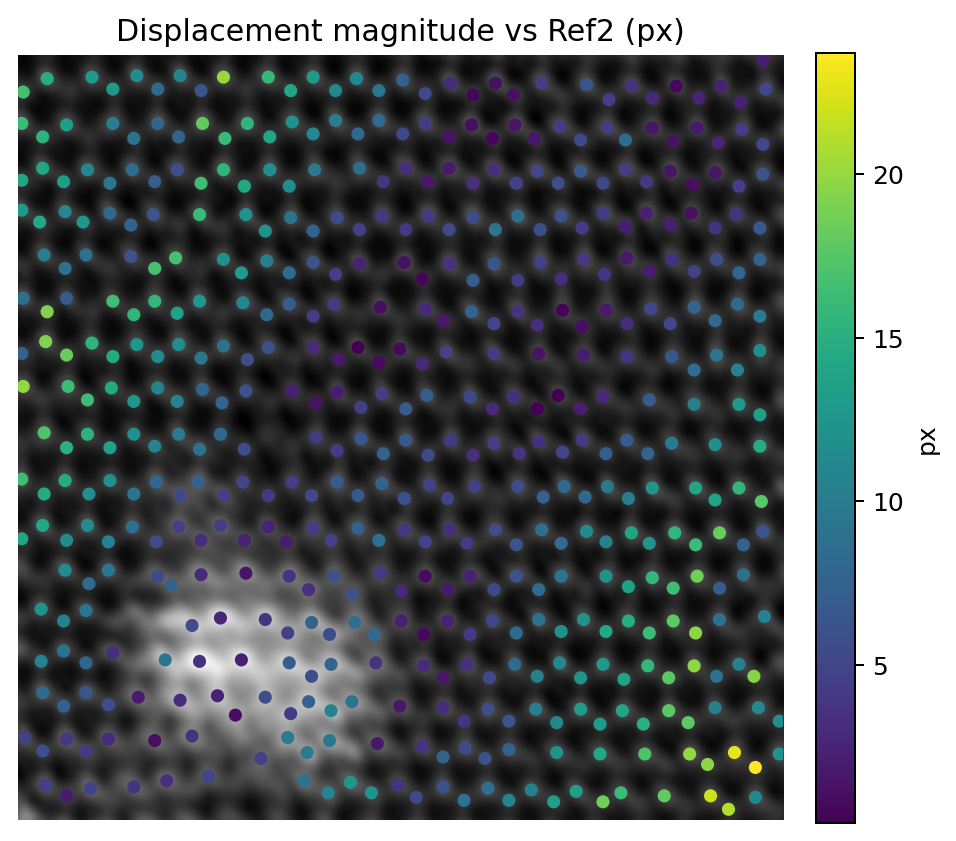

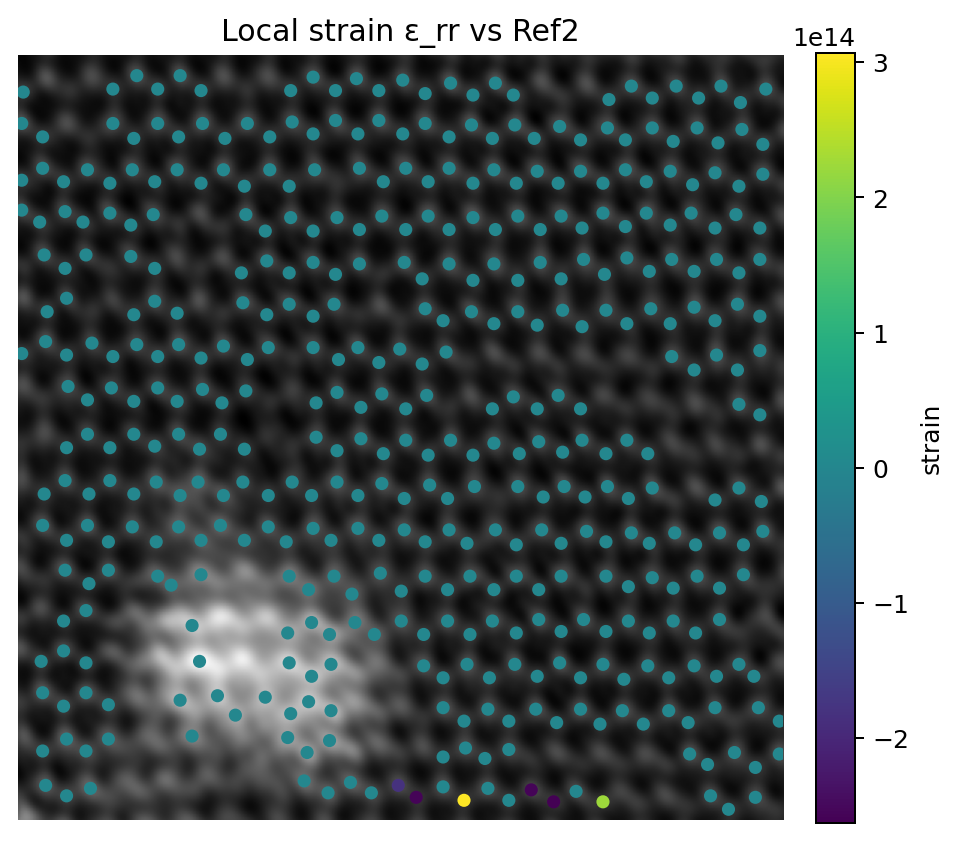

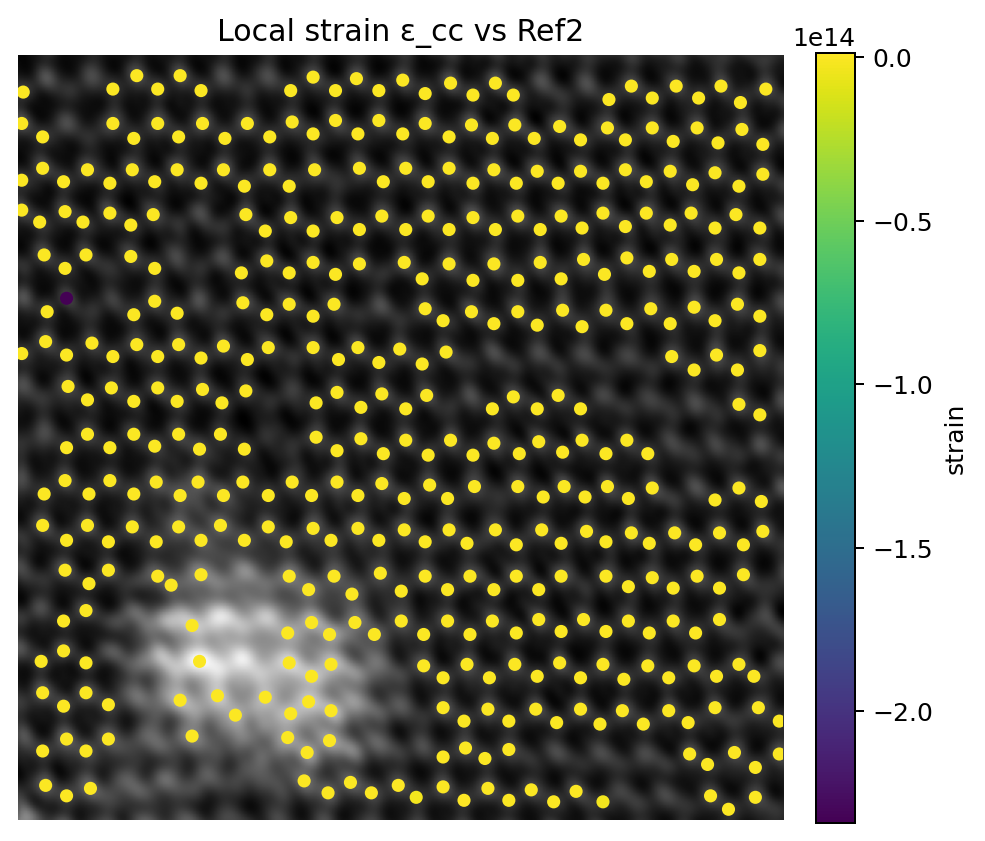

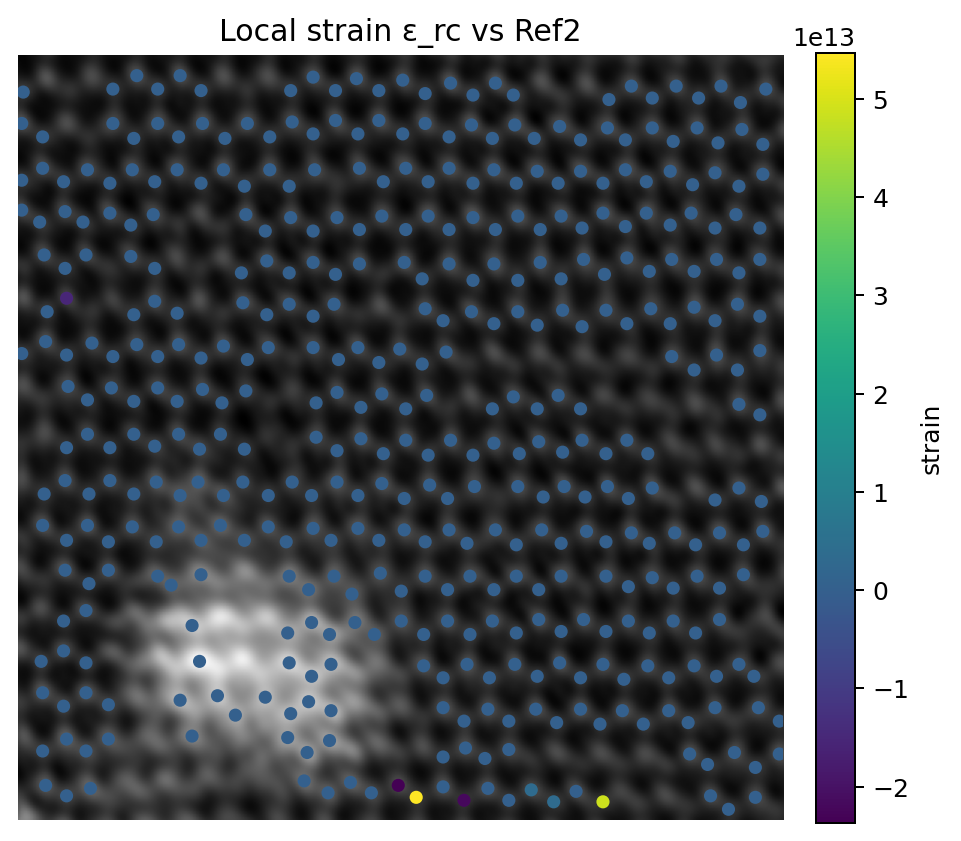

In [ ]:
def scatter_map(values, title, label, mask=None, s=18):
    plt.figure(figsize=(6,6), dpi=180)
    plt.imshow(img, cmap="gray")
    if mask is None:
        pts = atoms
        vals = values
    else:
        pts = atoms[mask]
        vals = values[mask]
    sc = plt.scatter(pts[:,1], pts[:,0], c=vals, s=s)
    plt.title(title)
    plt.axis("off")
    plt.colorbar(sc, fraction=0.046, pad=0.04, label=label)
    plt.show()

# Optional: mask out extreme non-crystalline points (model breakdown)
disp_thr = np.percentile(disp_mag, 95)  # or use Ref2 ROI 95% if you stored it
good = disp_mag <= disp_thr

scatter_map(disp_mag, "Displacement magnitude vs Ref2 (px)", "px")
scatter_map(exx, "Local strain ε_rr vs Ref2", "strain", mask=np.isfinite(exx))
scatter_map(eyy, "Local strain ε_cc vs Ref2", "strain", mask=np.isfinite(eyy))
scatter_map(exy, "Local strain ε_rc vs Ref2", "strain", mask=np.isfinite(exy))


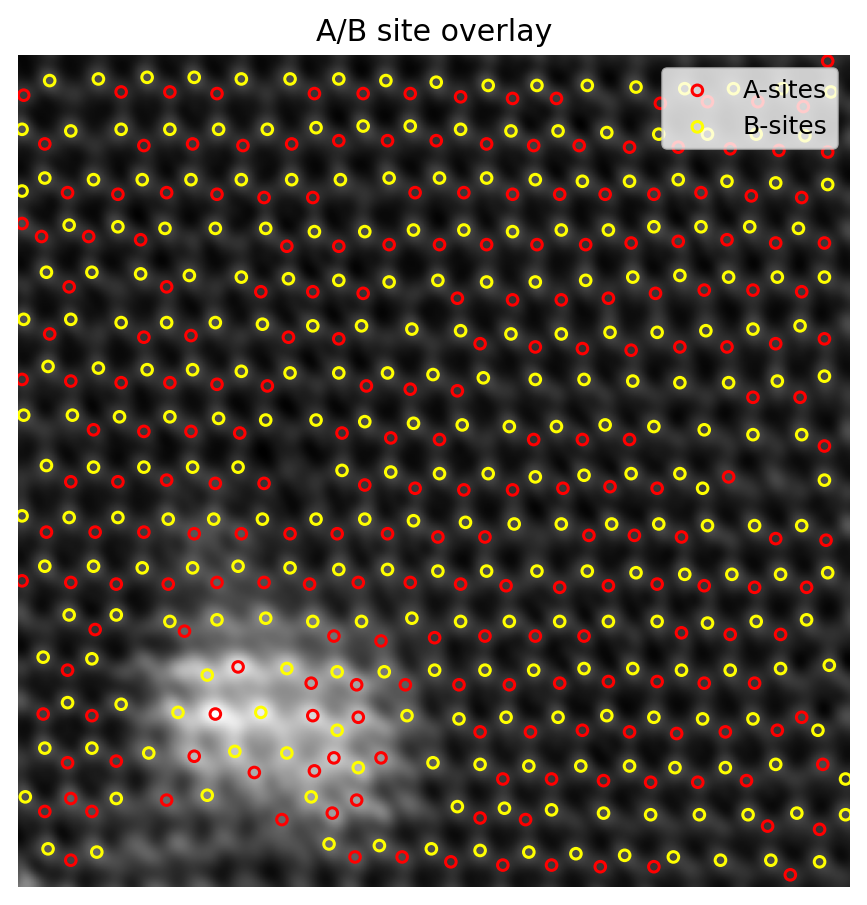

A count: 225 B count: 271


In [ ]:
A_idx = np.asarray(ASite, dtype=int)
B_idx = np.asarray(BSite, dtype=int)

A_atoms = atoms[A_idx]
B_atoms = atoms[B_idx]

plt.figure(figsize=(6,6), dpi=180)
plt.imshow(img, cmap="gray")
plt.scatter(A_atoms[:,1], A_atoms[:,0], s=18, facecolors="none", edgecolors="red", linewidths=1.2, label="A-sites")
plt.scatter(B_atoms[:,1], B_atoms[:,0], s=18, facecolors="none", edgecolors="yellow", linewidths=1.2, label="B-sites")
plt.title("A/B site overlay")
plt.axis("off")
plt.legend(loc="upper right")
plt.show()

print("A count:", len(A_atoms), "B count:", len(B_atoms))


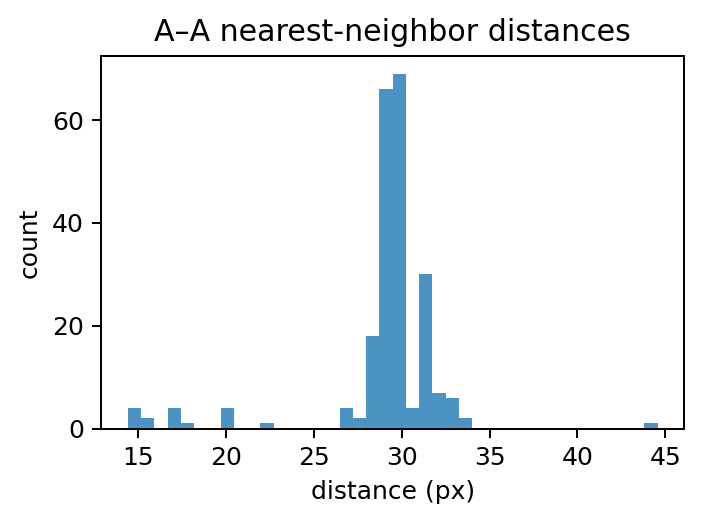

A–A nearest-neighbor distances median = 30.0 IQR = 1.0166620396072688


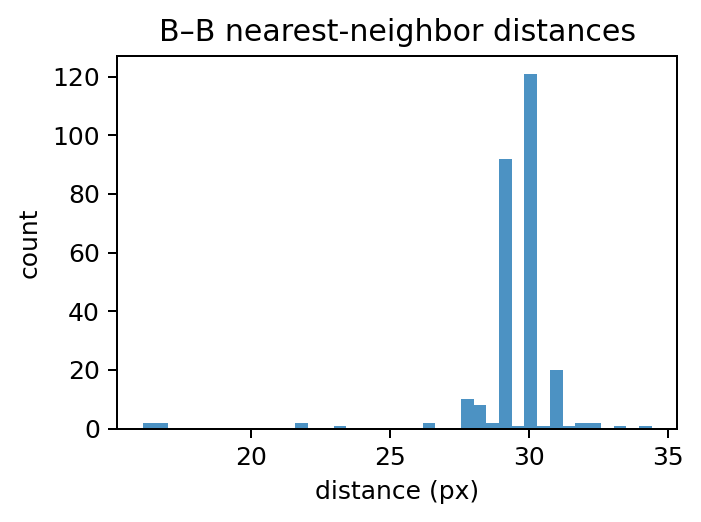

B–B nearest-neighbor distances median = 30.0 IQR = 0.9994257825134518


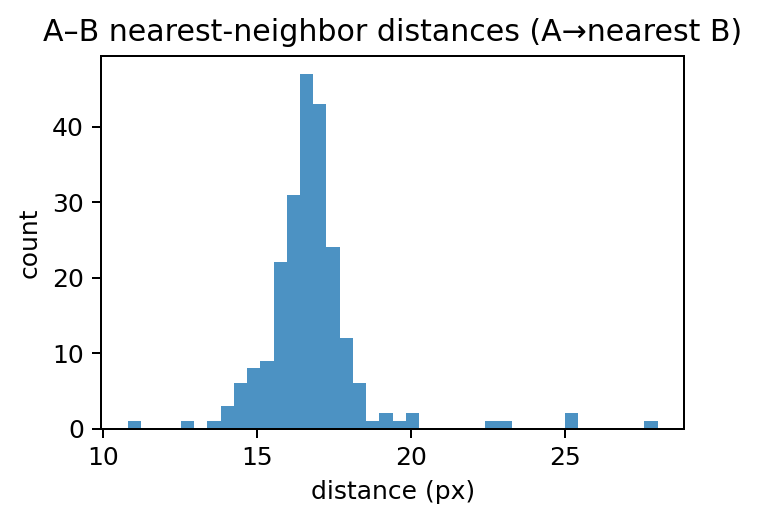

A–B nearest-neighbor distances (A→nearest B) median = 16.64331697709324 IQR = 1.080135037488155


In [ ]:
def nearest_distances(src_pts, dst_tree, k=1):
    # For each src point, find nearest neighbor in dst set
    d, _ = dst_tree.query(src_pts, k=k)
    return d if np.ndim(d) == 1 else d[:,0]

# Build trees
A_tree = cKDTree(A_atoms) if len(A_atoms) else None
B_tree = cKDTree(B_atoms) if len(B_atoms) else None

# A-A and B-B: use k=2 because nearest is itself when src==dst
AA = None
BB = None
if len(A_atoms) > 2:
    dAA, _ = A_tree.query(A_atoms, k=2)
    AA = dAA[:,1]  # nearest other A
if len(B_atoms) > 2:
    dBB, _ = B_tree.query(B_atoms, k=2)
    BB = dBB[:,1]  # nearest other B

# A-B and B-A
AB = None
BA = None
if len(A_atoms) and len(B_atoms):
    AB = nearest_distances(A_atoms, B_tree)  # each A to nearest B
    BA = nearest_distances(B_atoms, A_tree)  # each B to nearest A

def show_hist(data, title):
    if data is None:
        print(title, ": not enough points")
        return
    plt.figure(figsize=(4,3), dpi=180)
    plt.hist(data, bins=40, alpha=0.8)
    plt.title(title)
    plt.xlabel("distance (px)")
    plt.ylabel("count")
    plt.tight_layout()
    plt.show()
    print(title, "median =", float(np.median(data)), "IQR =", float(np.percentile(data,75)-np.percentile(data,25)))

show_hist(AA, "A–A nearest-neighbor distances")
show_hist(BB, "B–B nearest-neighbor distances")
show_hist(AB, "A–B nearest-neighbor distances (A→nearest B)")


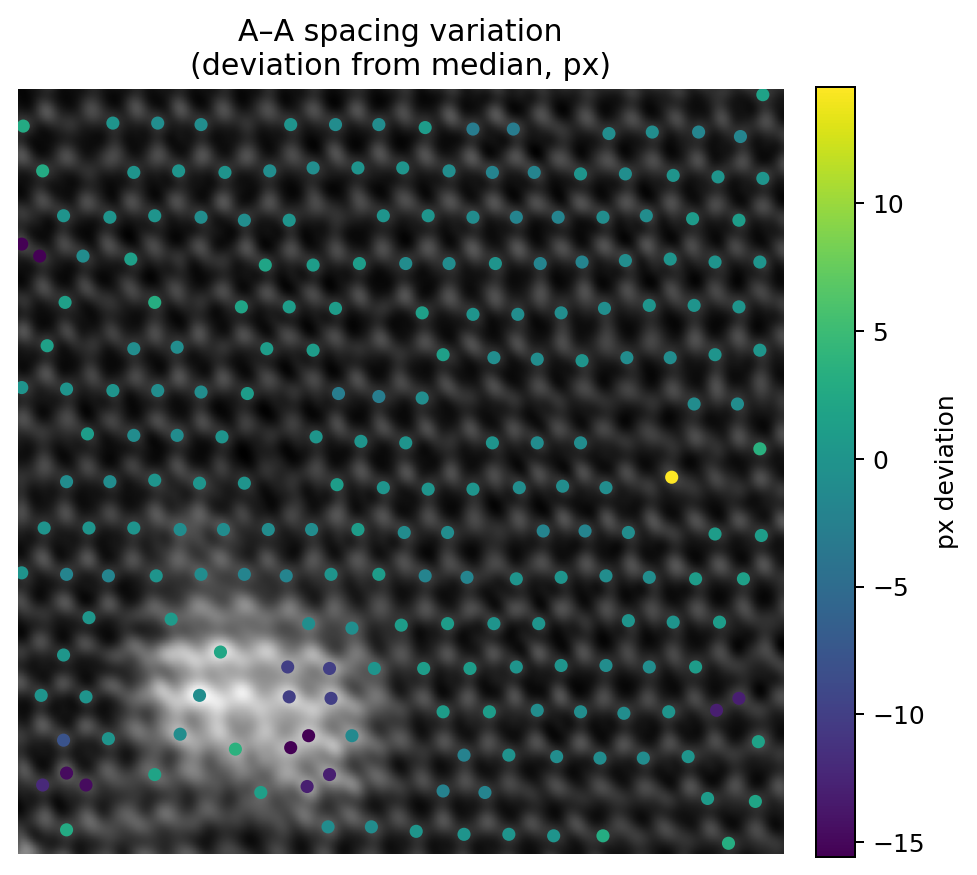

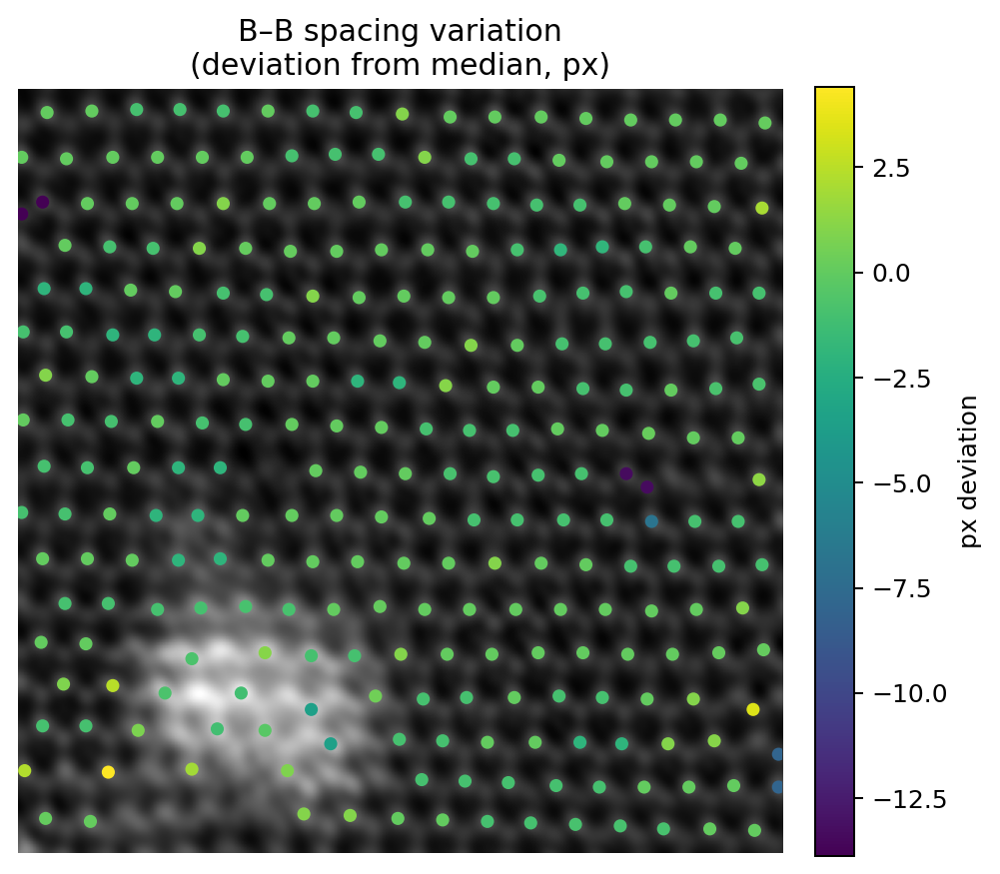

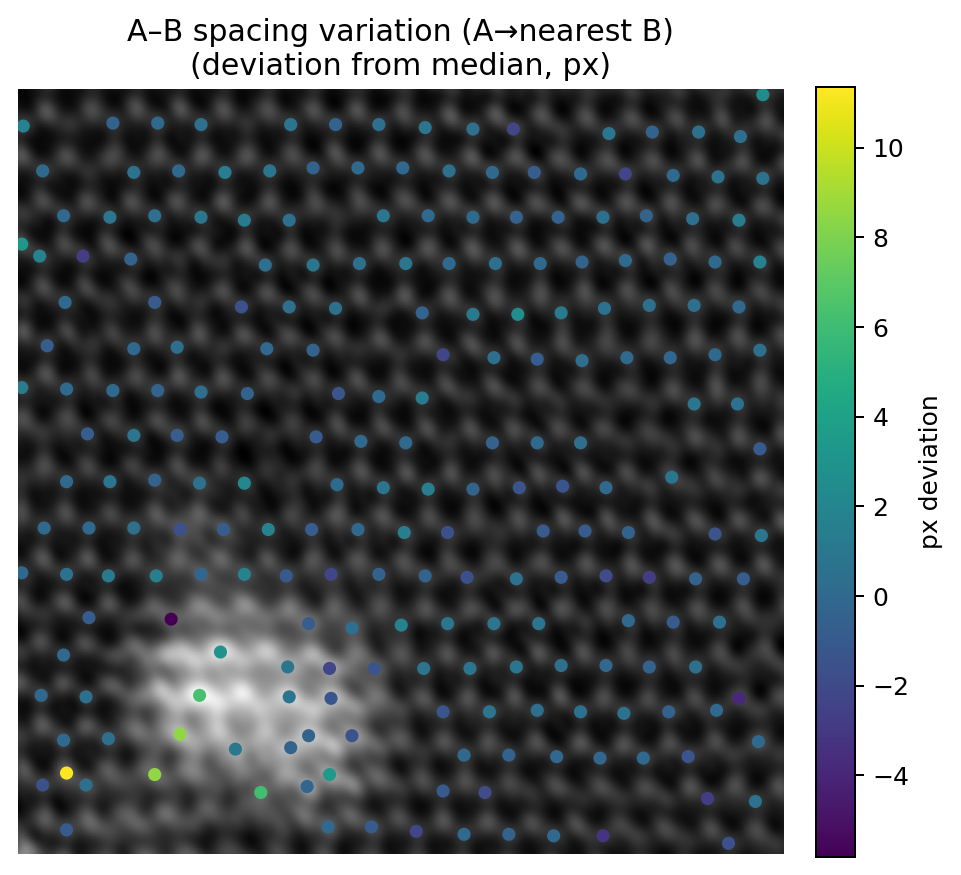

In [ ]:
def deviation_map(points, dists, title):
    if dists is None or len(dists) != len(points):
        print("Skipping:", title)
        return
    med = np.median(dists)
    dev = dists - med
    plt.figure(figsize=(6,6), dpi=180)
    plt.imshow(img, cmap="gray")
    sc = plt.scatter(points[:,1], points[:,0], c=dev, s=18)
    plt.title(f"{title}\n(deviation from median, px)")
    plt.axis("off")
    plt.colorbar(sc, fraction=0.046, pad=0.04, label="px deviation")
    plt.show()

deviation_map(A_atoms, AA, "A–A spacing variation")
deviation_map(B_atoms, BB, "B–B spacing variation")
deviation_map(A_atoms, AB, "A–B spacing variation (A→nearest B)")


A atoms: 225 B atoms: 271
Estimated A–B bond length (px, median): 16.64331697709324


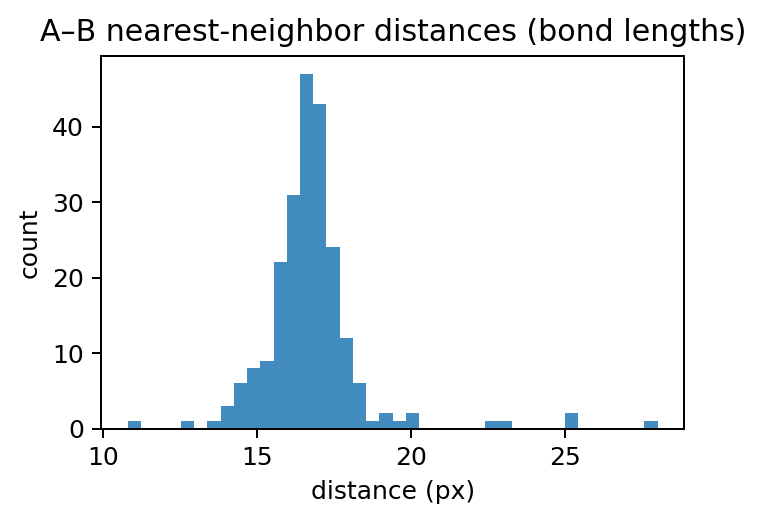

A–B mean bond length stats: median = 18.880317615960635 IQR = 1.104570012047425
A–B bond length std stats: median = 2.2712576278673313


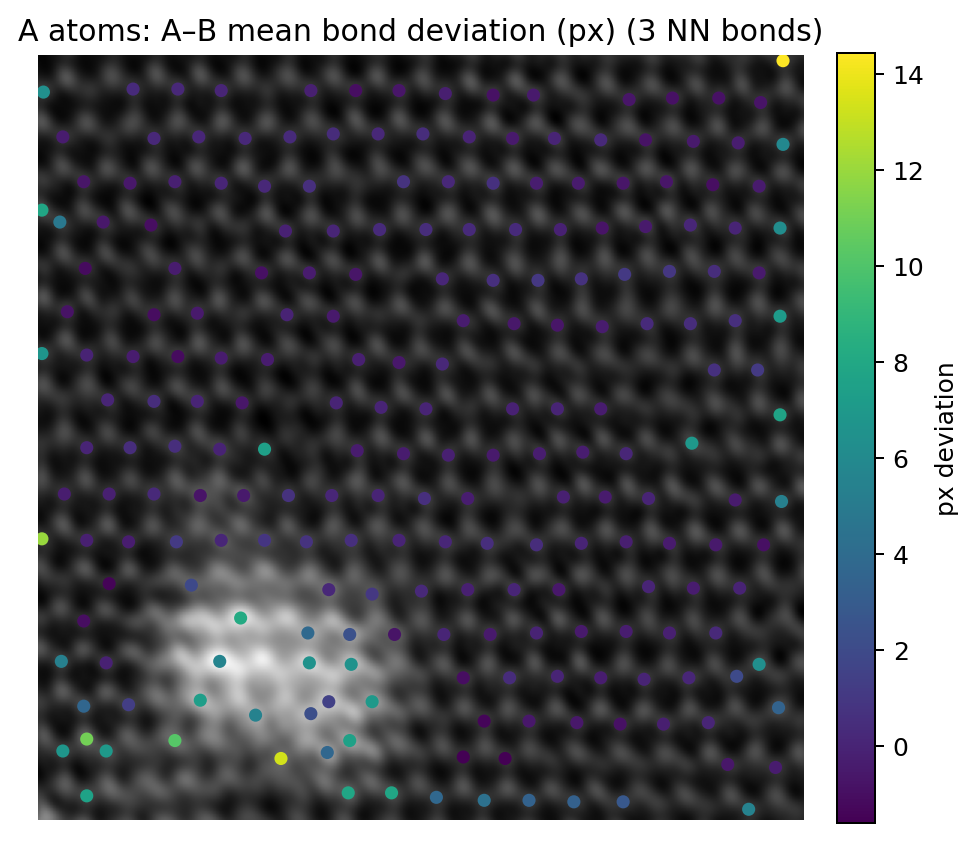

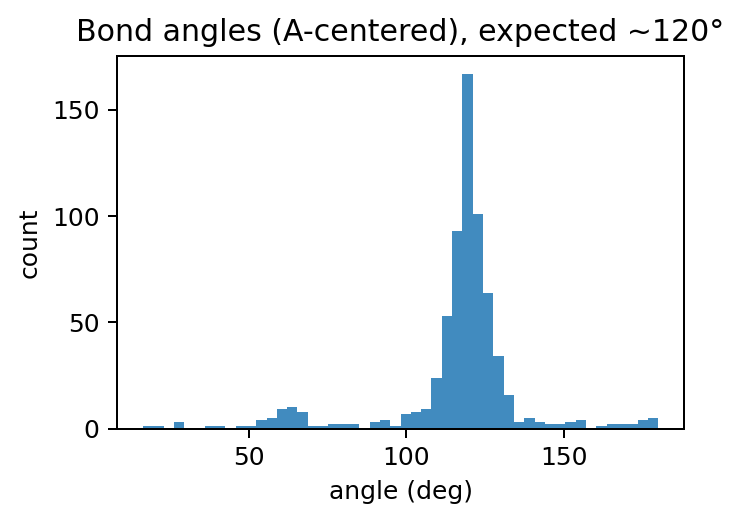

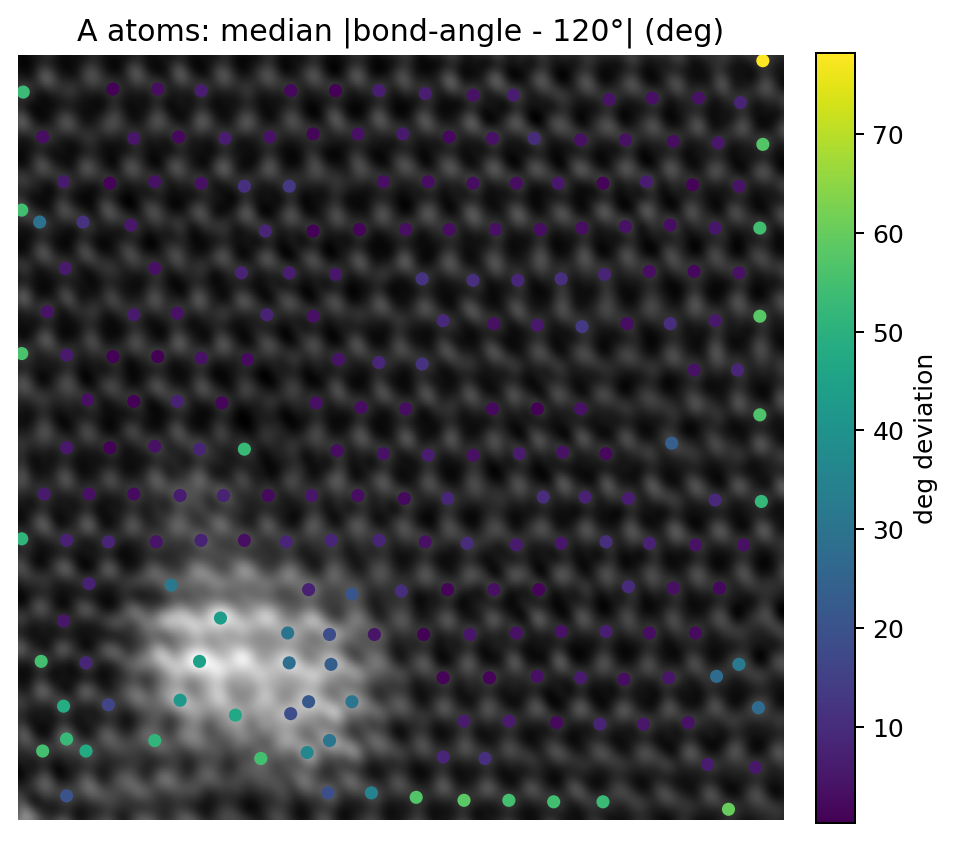

Expected same-sublattice (2nd neighbor) distance ≈ sqrt(3)*bond_len = 28.827070610799147
A–A shell count (should be ~6): median = 4
B–B shell count (should be ~6): median = 6


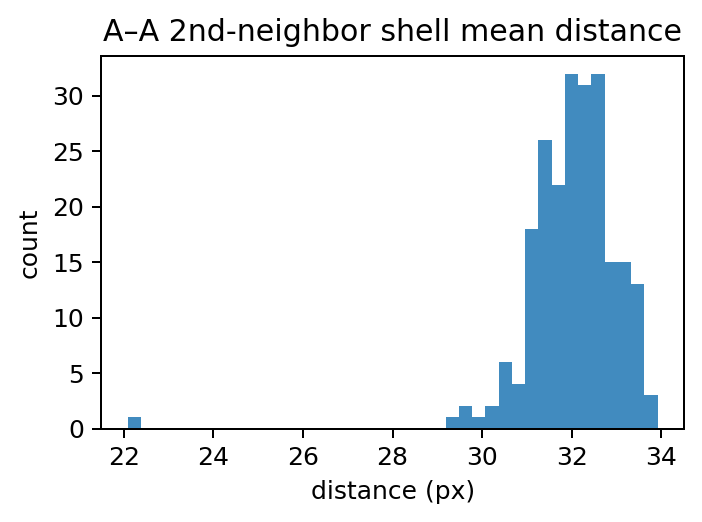

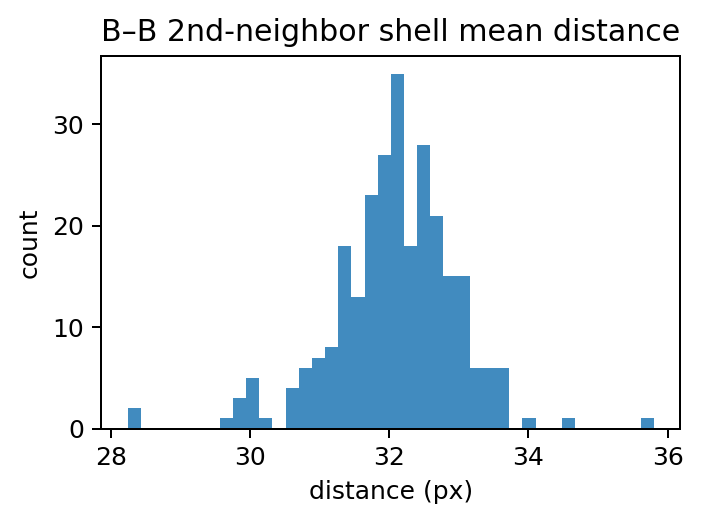

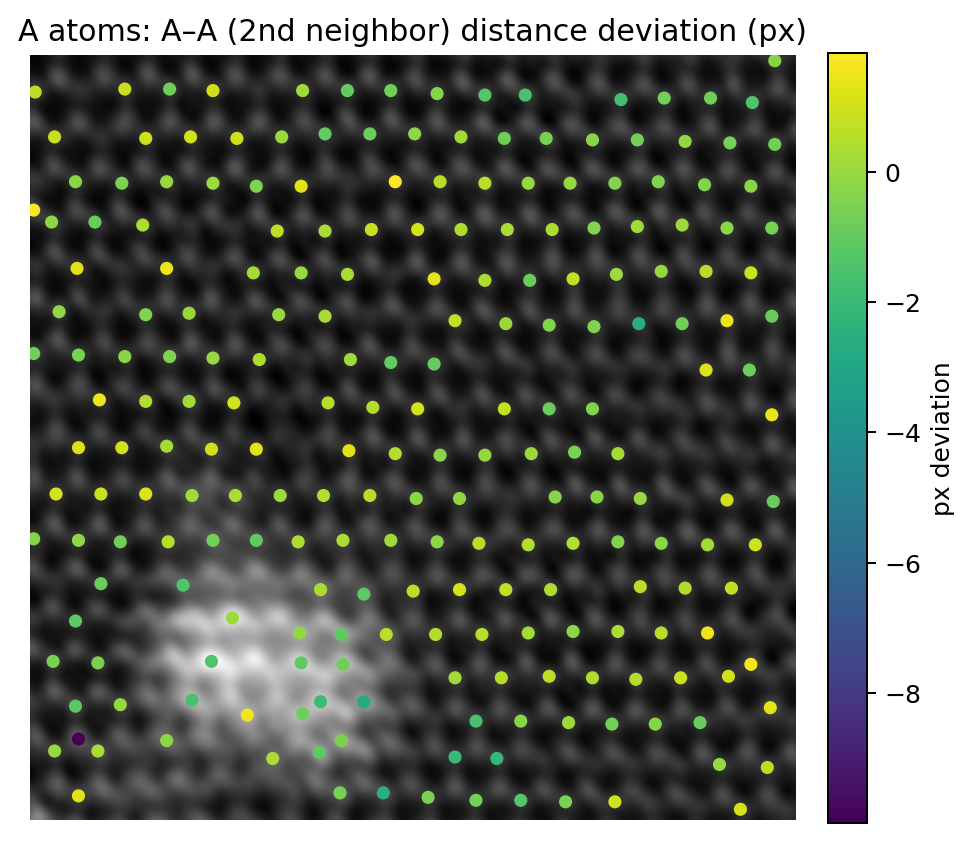

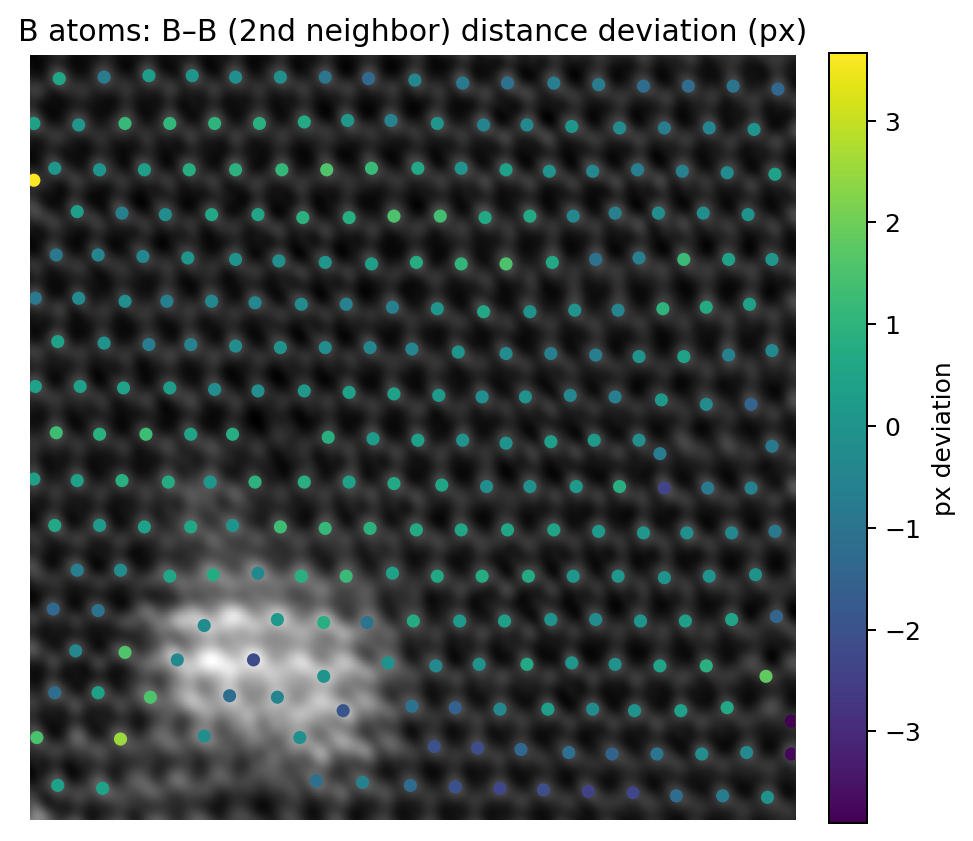

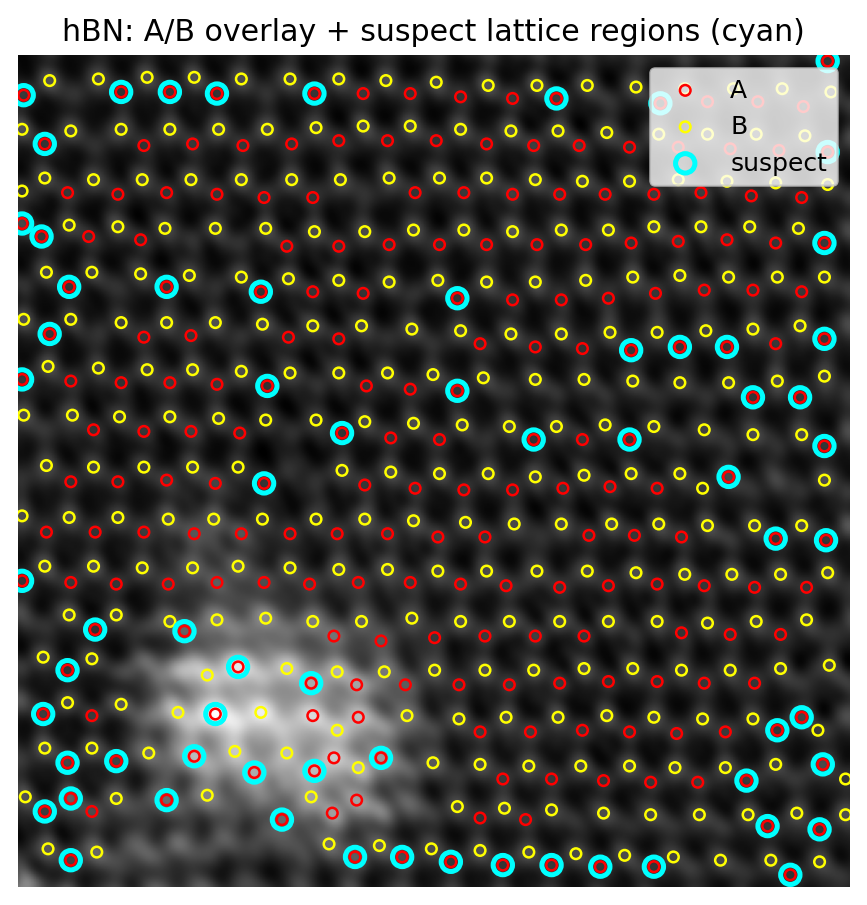

Suspect A-sites flagged: 68 out of 225


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial import cKDTree

img = np.asarray(nIm, dtype=float)
atoms = np.asarray(allatoms, dtype=float)  # [row,col]

# Use your existing ASite/BSite lists (geometry labels)
A_idx = np.asarray(ASite, dtype=int)   # e.g., B sublattice or N sublattice depending on your convention
B_idx = np.asarray(BSite, dtype=int)

A = atoms[A_idx]
B = atoms[B_idx]

A_tree = cKDTree(A)
B_tree = cKDTree(B)

print("A atoms:", len(A), "B atoms:", len(B))
# For each A, distance to nearest B (this should be the A–B bond length distribution)
dAB, idxAB = B_tree.query(A, k=1)
bond_len = float(np.median(dAB))

print("Estimated A–B bond length (px, median):", bond_len)

plt.figure(figsize=(4,3), dpi=180)
plt.hist(dAB, bins=40, alpha=0.85)
plt.title("A–B nearest-neighbor distances (bond lengths)")
plt.xlabel("distance (px)")
plt.ylabel("count")
plt.tight_layout()
plt.show()
# Find 3 nearest B neighbors for each A (in honeycomb, coordination is 3)
dAB3, idxAB3 = B_tree.query(A, k=3)   # shape (NA,3)
# per-atom bond metrics
AB_mean = dAB3.mean(axis=1)
AB_std  = dAB3.std(axis=1)
AB_dev  = AB_mean - np.median(AB_mean)

print("A–B mean bond length stats: median =", float(np.median(AB_mean)), "IQR =", float(np.percentile(AB_mean,75)-np.percentile(AB_mean,25)))
print("A–B bond length std stats: median =", float(np.median(AB_std)))

# Map: A–B mean bond deviation on image
plt.figure(figsize=(6,6), dpi=180)
plt.imshow(img, cmap="gray")
sc = plt.scatter(A[:,1], A[:,0], c=AB_dev, s=18)
plt.title("A atoms: A–B mean bond deviation (px) (3 NN bonds)")
plt.axis("off")
plt.colorbar(sc, fraction=0.046, pad=0.04, label="px deviation")
plt.show()
def angle_deg(v1, v2):
    v1 = np.asarray(v1, float); v2 = np.asarray(v2, float)
    n1 = np.linalg.norm(v1); n2 = np.linalg.norm(v2)
    if n1 < 1e-12 or n2 < 1e-12:
        return np.nan
    c = np.clip(np.dot(v1, v2) / (n1*n2), -1, 1)
    return np.degrees(np.arccos(c))

# compute the 3 bond vectors from A -> its 3 nearest B neighbors
angles_all = []
angle_dev_per_A = np.full(len(A), np.nan)

for i in range(len(A)):
    a = A[i]
    bs = B[idxAB3[i]]  # 3 neighbors
    vecs = bs - a      # 3 vectors in [row,col]

    # three pairwise angles among 3 vectors
    angs = []
    for p in range(3):
        for q in range(p+1, 3):
            angs.append(angle_deg(vecs[p], vecs[q]))
    angs = np.array(angs, float)  # should be near 120

    angles_all.extend(list(angs))
    angle_dev_per_A[i] = np.nanmedian(np.abs(angs - 120.0))

angles_all = np.array(angles_all, float)

plt.figure(figsize=(4,3), dpi=180)
plt.hist(angles_all[np.isfinite(angles_all)], bins=50, alpha=0.85)
plt.title("Bond angles (A-centered), expected ~120°")
plt.xlabel("angle (deg)")
plt.ylabel("count")
plt.tight_layout()
plt.show()

plt.figure(figsize=(6,6), dpi=180)
plt.imshow(img, cmap="gray")
sc = plt.scatter(A[:,1], A[:,0], c=angle_dev_per_A, s=18)
plt.title("A atoms: median |bond-angle - 120°| (deg)")
plt.axis("off")
plt.colorbar(sc, fraction=0.046, pad=0.04, label="deg deviation")
plt.show()
expected_same = np.sqrt(3) * bond_len
print("Expected same-sublattice (2nd neighbor) distance ≈ sqrt(3)*bond_len =", expected_same)

# Query several same-sublattice neighbors and keep those near expected_same
def same_sublattice_shell(points, tree, expected, tol=0.25, k=12):
    """
    points: (N,2)
    tree: KDTree built on same points
    expected: expected shell radius
    tol: +/- fraction window (0.25 = 25%)
    k: number of neighbors to query (include enough to capture shell)
    Returns:
      shell_mean_dist per point, shell_count per point
    """
    d, idx = tree.query(points, k=k)
    # d[:,0] is 0 (self). ignore it.
    d = d[:,1:]
    lo, hi = expected*(1-tol), expected*(1+tol)
    mask = (d >= lo) & (d <= hi)
    # mean distance in shell
    shell_mean = np.array([np.mean(di[mi]) if np.any(mi) else np.nan for di, mi in zip(d, mask)], float)
    shell_count = np.array([np.sum(mi) for mi in mask], int)
    return shell_mean, shell_count

AA_mean, AA_count = same_sublattice_shell(A, A_tree, expected_same, tol=0.25, k=14)
BB_mean, BB_count = same_sublattice_shell(B, B_tree, expected_same, tol=0.25, k=14)

print("A–A shell count (should be ~6): median =", int(np.nanmedian(AA_count)))
print("B–B shell count (should be ~6): median =", int(np.nanmedian(BB_count)))

plt.figure(figsize=(4,3), dpi=180)
plt.hist(AA_mean[np.isfinite(AA_mean)], bins=40, alpha=0.85)
plt.title("A–A 2nd-neighbor shell mean distance")
plt.xlabel("distance (px)")
plt.ylabel("count")
plt.tight_layout()
plt.show()

plt.figure(figsize=(4,3), dpi=180)
plt.hist(BB_mean[np.isfinite(BB_mean)], bins=40, alpha=0.85)
plt.title("B–B 2nd-neighbor shell mean distance")
plt.xlabel("distance (px)")
plt.ylabel("count")
plt.tight_layout()
plt.show()

# maps
plt.figure(figsize=(6,6), dpi=180)
plt.imshow(img, cmap="gray")
sc = plt.scatter(A[:,1], A[:,0], c=(AA_mean - np.nanmedian(AA_mean)), s=18)
plt.title("A atoms: A–A (2nd neighbor) distance deviation (px)")
plt.axis("off")
plt.colorbar(sc, fraction=0.046, pad=0.04, label="px deviation")
plt.show()

plt.figure(figsize=(6,6), dpi=180)
plt.imshow(img, cmap="gray")
sc = plt.scatter(B[:,1], B[:,0], c=(BB_mean - np.nanmedian(BB_mean)), s=18)
plt.title("B atoms: B–B (2nd neighbor) distance deviation (px)")
plt.axis("off")
plt.colorbar(sc, fraction=0.046, pad=0.04, label="px deviation")
plt.show()
# Flag rules (tune if needed)
suspect = (
    (AB_std > np.percentile(AB_std, 90)) |                 # unstable bonds
    (angle_dev_per_A > np.nanpercentile(angle_dev_per_A, 90)) |  # strong angular distortion
    (AA_count < 4)                                          # missing same-sublattice shell neighbors
)

plt.figure(figsize=(6,6), dpi=180)
plt.imshow(img, cmap="gray")
plt.scatter(A[:,1], A[:,0], s=18, facecolors="none", edgecolors="red", linewidths=1.0, label="A")
plt.scatter(B[:,1], B[:,0], s=18, facecolors="none", edgecolors="yellow", linewidths=1.0, label="B")
plt.scatter(A[suspect,1], A[suspect,0], s=60, facecolors="none", edgecolors="cyan", linewidths=2.0, label="suspect")
plt.title("hBN: A/B overlay + suspect lattice regions (cyan)")
plt.axis("off")
plt.legend(loc="upper right")
plt.show()

print("Suspect A-sites flagged:", int(np.sum(suspect)), "out of", len(A))


In [ ]:
import numpy as np
from scipy.spatial import cKDTree

# Inputs needed:
#   allatoms : list/array of [row,col]
#   r        : peak radius (only for plotting later; not needed here)
# Optional:
#   nn_max_factor : how far to search for the 3 nearest neighbors

pts = np.asarray(allatoms, dtype=float)  # (N,2) [row,col]
N = len(pts)
tree = cKDTree(pts)

# --- 1) Estimate typical NN distance (for hBN first shell)
d2, idx2 = tree.query(pts, k=2)
nn = float(np.median(d2[:,1]))
print("Estimated NN distance (px):", nn)

# --- 2) For each atom, get its 3 nearest neighbors (should be opposite sublattice)
# We query a few neighbors and then take the 3 closest within a cutoff
k_query = 10
dK, idxK = tree.query(pts, k=k_query)

cutoff = 1.35 * nn  # first-shell cutoff (tune 1.25-1.45)
neighbors3 = []
valid3 = np.zeros(N, dtype=bool)

for i in range(N):
    # skip self at position 0
    cand = [(dK[i,j], idxK[i,j]) for j in range(1, k_query) if dK[i,j] < cutoff]
    cand.sort(key=lambda x: x[0])
    if len(cand) >= 3:
        neighbors3.append([cand[0][1], cand[1][1], cand[2][1]])
        valid3[i] = True
    else:
        neighbors3.append([])

# --- 3) Determine a global "vertical" axis in lattice coordinates
# For hBN, one bond direction can be used as a reference. We estimate it from all first-shell vectors.
vecs = []
for i in range(N):
    if not valid3[i]:
        continue
    for j in neighbors3[i]:
        vecs.append(pts[j] - pts[i])  # [drow, dcol]
vecs = np.asarray(vecs, dtype=float)

# Normalize, fold sign to treat v and -v as same
vn = vecs / (np.linalg.norm(vecs, axis=1, keepdims=True) + 1e-12)
vn = np.where(vn[:,[0]] < 0, -vn, vn)

# PCA: first principal direction is one dominant bond axis
C = vn - vn.mean(axis=0)
_, _, Vt = np.linalg.svd(C, full_matrices=False)
bond_axis = Vt[0]
bond_axis = bond_axis / (np.linalg.norm(bond_axis) + 1e-12)

# Define "up" direction as +bond_axis projected along row (arbitrary sign choice)
# If you want "up" to mean decreasing row (image up), flip as needed:
if bond_axis[0] > 0:
    bond_axis = -bond_axis

print("Chosen lattice 'vertical' axis (row,col):", bond_axis)

# --- 4) Apply the 1-up/2-down rule using projections onto bond_axis
# For each atom: compute signed projections of its 3 neighbor vectors on bond_axis.
# Count how many are "above" (negative projection -> up in image if axis points up).
B_idx = []
N_idx = []
unclassified = []
confidence = np.full(N, np.nan)

for i in range(N):
    if not valid3[i]:
        unclassified.append(i)
        continue

    nbrs = neighbors3[i]
    v = pts[nbrs] - pts[i]            # (3,2)
    proj = v @ bond_axis              # signed scalar projections

    # Count "above" vs "below" using sign
    # If bond_axis points up, then proj < 0 means neighbor is "above"
    above = int(np.sum(proj < 0))
    below = 3 - above

    # confidence: how separated the above/below groups are (bigger = cleaner)
    # if all projections are near 0, it's ambiguous
    confidence[i] = float(np.mean(np.abs(proj)) / (nn + 1e-12))

    if (above, below) == (1, 2):
        B_idx.append(i)   # your statement: B has 1 above, 2 below
    elif (above, below) == (2, 1):
        N_idx.append(i)   # N has 2 above, 1 below
    else:
        unclassified.append(i)

B_idx = np.asarray(B_idx, dtype=int)
N_idx = np.asarray(N_idx, dtype=int)
unclassified = np.asarray(unclassified, dtype=int)

print("B classified:", len(B_idx), "N classified:", len(N_idx), "Unclassified:", len(unclassified))

# Optional: filter out low-confidence assignments (helps near blob/edges)
conf_thr = np.nanpercentile(confidence[np.isfinite(confidence)], 20)  # keep top 80%
good_B = B_idx[confidence[B_idx] >= conf_thr]
good_N = N_idx[confidence[N_idx] >= conf_thr]
print("After confidence filter:", "B:", len(good_B), "N:", len(good_N))


Estimated NN distance (px): 16.64331697709324
Chosen lattice 'vertical' axis (row,col): [-0.02794637 -0.99960942]
B classified: 118 N classified: 142 Unclassified: 241
After confidence filter: B: 94 N: 120


In [ ]:
import numpy as np
from scipy.spatial import cKDTree

pts = np.asarray(allatoms, dtype=float)  # (N,2) [row,col]
N = len(pts)
tree = cKDTree(pts)

# --- Estimate NN distance
d2, _ = tree.query(pts, k=2)
nn = float(np.median(d2[:, 1]))
print("Estimated NN distance (px):", nn)

# --- Choose 3 nearest neighbors, but with a sanity check on the 3rd distance
k_query = 12
dK, idxK = tree.query(pts, k=k_query)

# Relaxed controls
max_third = 1.7 * nn   # allow strain/rotation; prevents 2nd-shell being chosen (tune 1.45-1.70)
min_third = 0.85 * nn   # prevents duplicates/too-close junk (tune 0.6-0.85)

neighbors3 = np.full((N, 3), -1, dtype=int)
valid3 = np.zeros(N, dtype=bool)

for i in range(N):
    cand_d = dK[i, 1:]      # exclude self
    cand_j = idxK[i, 1:]
    # take the 3 closest
    order = np.argsort(cand_d)
    pick_d = cand_d[order[:3]]
    pick_j = cand_j[order[:3]]

    # check 3rd neighbor distance is plausible for 1st shell
    if (pick_d[2] < max_third) and (pick_d[2] > min_third):
        neighbors3[i] = pick_j
        valid3[i] = True

print("Atoms with valid 3-NN sets:", int(valid3.sum()), "/", N)

# ------------------------------------------------------------
# Axis search: pick direction that yields most consistent 1/2 split
# ------------------------------------------------------------
# For each candidate axis, score how many atoms show a clean (1,2) or (2,1) split.
# Also reject ambiguous projections near 0.
eps_proj = 0.08 * nn  # margin to avoid sign flips near boundary (tune 0.05-0.15)

def score_axis(axis):
    axis = axis / (np.linalg.norm(axis) + 1e-12)
    good = 0
    ambiguous = 0
    for i in range(N):
        if not valid3[i]:
            continue
        nbrs = neighbors3[i]
        v = pts[nbrs] - pts[i]           # (3,2)
        proj = v @ axis                  # signed
        # mark ambiguous if any projection is too close to 0
        if np.any(np.abs(proj) < eps_proj):
            ambiguous += 1
            continue
        above = int(np.sum(proj < 0))
        below = 3 - above
        if (above, below) in [(1,2), (2,1)]:
            good += 1
    return good, ambiguous

# Search over angles (in row/col coordinate system)
# axis = [sin(theta), cos(theta)] so theta=0 points +col, theta=pi/2 points +row
thetas = np.linspace(-np.pi/2, np.pi/2, 181)
best = None
for th in thetas:
    axis = np.array([np.sin(th), np.cos(th)], dtype=float)
    good, amb = score_axis(axis)
    if best is None or good > best[0]:
        best = (good, amb, th)

best_good, best_amb, best_th = best
axis = np.array([np.sin(best_th), np.cos(best_th)], dtype=float)

# Optional: force axis "up" to correspond to decreasing row (image up)
# If you prefer, flip sign
if axis[0] > 0:
    axis = -axis

print("Chosen axis theta(deg):", float(np.degrees(best_th)))
print("Axis (row,col):", axis)
print("Axis score: good =", best_good, " ambiguous-skipped =", best_amb)

# ------------------------------------------------------------
# Classify using relaxed + robust decision
# ------------------------------------------------------------
B_idx = []
N_idx = []
unclassified = []
confidence = np.full(N, np.nan)

for i in range(N):
    if not valid3[i]:
        unclassified.append(i)
        continue

    nbrs = neighbors3[i]
    v = pts[nbrs] - pts[i]
    proj = v @ axis

    # if ambiguous projections, skip (can later recover by intensity or local ref)
    if np.any(np.abs(proj) < eps_proj):
        unclassified.append(i)
        continue

    above = int(np.sum(proj < 0))
    below = 3 - above

    # confidence: average |projection| normalized by nn
    confidence[i] = float(np.mean(np.abs(proj)) / (nn + 1e-12))

    if (above, below) == (1,2):
        B_idx.append(i)  # your rule
    elif (above, below) == (2,1):
        N_idx.append(i)
    else:
        unclassified.append(i)

B_idx = np.asarray(B_idx, dtype=int)
N_idx = np.asarray(N_idx, dtype=int)
unclassified = np.asarray(unclassified, dtype=int)

print("B classified:", len(B_idx), "N classified:", len(N_idx), "Unclassified:", len(unclassified))

# Optional mild confidence filter (less strict than before)
if np.any(np.isfinite(confidence)):
    conf_thr = np.nanpercentile(confidence[np.isfinite(confidence)], 10)  # keep top 90%
    good_B = B_idx[confidence[B_idx] >= conf_thr]
    good_N = N_idx[confidence[N_idx] >= conf_thr]
else:
    good_B, good_N = B_idx, N_idx

print("After confidence filter:", "B:", len(good_B), "N:", len(good_N))


Estimated NN distance (px): 16.64331697709324
Atoms with valid 3-NN sets: 337 / 501
Chosen axis theta(deg): -83.0
Axis (row,col): [-0.99254615  0.12186934]
Axis score: good = 336  ambiguous-skipped = 0
B classified: 194 N classified: 142 Unclassified: 165
After confidence filter: B: 177 N: 126
